# Preparations

In [1]:
import os, sys
import csv
import urllib.request
import sklearn
import random
import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import warnings
import seaborn as sns
import statsmodels.api as sm
import logging
from IPython.display import display

#ML
from sklearn import metrics
from sklearn.model_selection import cross_validate, cross_val_score
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import SimpleImputer, IterativeImputer, KNNImputer
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler, power_transform, minmax_scale, PowerTransformer
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer

#For the plots
%matplotlib inline
mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)
warnings.filterwarnings('ignore')
plt.style.use('ggplot')


In [2]:
random_state = 42
# np.random.seed = random_state
rng = np.random.default_rng(random_state)

In [3]:
song = pd.read_csv('../data/processed/train.csv')
song.drop(['id'], inplace=True, axis=1)

song_test = pd.read_csv('../data/processed/test.csv')
song_test.drop(['id'], inplace=True, axis=1)

In [4]:
song['isTrain'] = True
song_test['isTrain'] = False

tt = pd.concat([song, song_test]).reset_index(drop=True).copy()
song.drop(['isTrain'], inplace=True, axis=1)
song_test.drop(['isTrain'], inplace=True, axis=1)
tt.tail()

,song_duration_ms,acousticness,danceability,energy,instrumentalness,key,liveness,loudness,audio_mode,speechiness,tempo,time_signature,audio_valence,song_popularity,isTrain
49995,196204.0,0.083936,0.823252,0.442246,0.002990,1.0,0.123921,-8.682195,1,0.041171,98.264618,4,0.784104,NaN,False
49996,218343.0,0.105279,0.683743,0.848627,0.001911,6.0,0.106522,-4.946250,0,0.033605,103.949646,4,0.850754,NaN,False
49997,188434.0,0.753472,0.783947,0.498261,0.134027,6.0,0.088147,-11.812606,1,0.029526,119.090558,4,0.482961,NaN,False
49998,173044.0,0.863579,0.373283,0.476142,0.000049,10.0,0.122122,-12.371232,0,0.190628,103.048349,3,0.518742,NaN,False
49999,157896.0,0.019852,0.720380,NaN,0.037727,2.0,0.139422,-4.965311,1,0.053257,109.873611,4,0.971368,NaN,False


In [5]:
col_y = 'song_popularity'

X = song.copy()
y = X.pop(col_y)

X_clean = X.dropna(how='any')
y_clean = y.loc[~X.isna().any(axis=1)]

In [6]:
X_train, y_train, X_test, y_test = sklearn.model_selection.train_test_split(X, y, test_size=0.2, random_state=random_state, stratify=y)

X_train_clean, y_train_clean, X_test_clean, y_test_clean = sklearn.model_selection.train_test_split(X_clean, y_clean, test_size=0.2, random_state=random_state, stratify=y_clean)

In [7]:
# get all column names except song_popularity
FEATURES = [c for c in X.columns.tolist() if c != col_y]
FEATURES

['song_duration_ms',
 'acousticness',
 'danceability',
 'energy',
 'instrumentalness',
 'key',
 'liveness',
 'loudness',
 'audio_mode',
 'speechiness',
 'tempo',
 'time_signature',
 'audio_valence']

In [8]:
song.shape, song_test.shape, tt.shape

((40000, 14), (10000, 13), (50000, 15))

# Overview: Structure and Data Content

### Data descrption

Source - Spotify: "In Spotify's API is something called Valence, that describes the musical positiveness conveyed by a track. Tracks with high valence sound more positive (happy, cheerful, euphoric), while tracks with low valence sound more negative (sad, depressed, angry)."

[**From very good article explaining Spotify API What Makes a Song Likeable**?](https://towardsdatascience.com/what-makes-a-song-likeable-dbfdb7abe404)- we can read that:

---

Spotify Audio Features
For every track on their platform, Spotify provides data for thirteen Audio Features.The Spotify Web API developer guide defines them as follows:

* **Danceability:** Describes how suitable a track is for dancing based on a combination of musical elements including tempo, rhythm stability, beat strength, and overall regularity.

* **Valence**: Describes the musical positiveness conveyed by a track. Tracks with high valence sound more positive (e.g. happy, cheerful, euphoric), while tracks with low valence sound more negative (e.g. sad, depressed, angry).

* **Energy**: Represents a perceptual measure of intensity and activity. Typically, energetic tracks feel fast, loud, and noisy. For example, death metal has high energy, while a Bach prelude scores low on the scale.

* **Tempo**: The overall estimated tempo of a track in beats per minute (BPM). In musical terminology, tempo is the speed or pace of a given piece, and derives directly from the average beat duration.

* **Loudness**: The overall loudness of a track in decibels (dB). Loudness values are averaged across the entire track and are useful for comparing relative loudness of tracks.

* **Speechiness**: This detects the presence of spoken words in a track. The more exclusively speech-like the recording (e.g. talk show, audio book, poetry), the closer to 1.0 the attribute value.
Instrumentalness: Predicts whether a track contains no vocals. “Ooh” and “aah” sounds are treated as instrumental in this context. Rap or spoken word tracks are clearly “vocal”.

* **Liveness**: Detects the presence of an audience in the recording. Higher liveness values represent an increased probability that the track was performed live.

* **Acousticness**: A confidence measure from 0.0 to 1.0 of whether the track is acoustic.

* **Key**: The estimated overall key of the track. Integers map to pitches using standard Pitch Class notation . E.g. 0 = C, 1 = C♯/D♭, 2 = D, and so on.

* **Mode**: Indicates the modality (major or minor) of a track, the type of scale from which its melodic content is derived. Major is represented by 1 and minor is 0.

* **Duration**: The duration of the track in milliseconds.

* **Time Signature**: An estimated overall time signature of a track. The time signature (meter) is a notational convention to specify how many beats are in each bar (or measure).

Data Provided by Remek Kinas [SOURCE](https://www.kaggle.com/c/song-popularity-prediction/discussion/301616)

---

Resources for EDA:
* [Song Popularity Prediction EDA with Martin Henze (Heads or Tails)](https://www.youtube.com/watch?v=JXF-7rCcR1c)
* [Song Popularity Prediction: EDA with Martin Henze (Part-2)](https://www.youtube.com/watch?v=2aE6SvCVOis&ab_channel=AbhishekThakur)
* [Song Popularity EDA - Live Coding Fun - Martin Notebook](https://www.kaggle.com/headsortails/song-popularity-eda-live-coding-fun)

## Look at the Data

In [9]:
# check top 5 samples/records
song.head()

,song_duration_ms,acousticness,danceability,energy,instrumentalness,key,liveness,loudness,audio_mode,speechiness,tempo,time_signature,audio_valence,song_popularity
0,212990.0,0.642286,0.856520,0.707073,0.002001,10.0,NaN,-5.619088,0,0.082570,158.386236,4,0.734642,0
1,NaN,0.054866,0.733289,0.835545,0.000996,8.0,0.436428,-5.236965,1,0.127358,102.752988,3,0.711531,1
2,193213.0,NaN,0.188387,0.783524,-0.002694,5.0,0.170499,-4.951759,0,0.052282,178.685791,3,0.425536,0
3,249893.0,0.488660,0.585234,0.552685,0.000608,0.0,0.094805,-7.893694,0,0.035618,128.715630,3,0.453597,0
4,165969.0,0.493017,NaN,0.740982,0.002033,10.0,0.094891,-2.684095,0,0.050746,121.928157,4,0.741311,0


In [10]:

song.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40000 entries, 0 to 39999
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   song_duration_ms  35899 non-null  float64
 1   acousticness      36008 non-null  float64
 2   danceability      35974 non-null  float64
 3   energy            36025 non-null  float64
 4   instrumentalness  36015 non-null  float64
 5   key               35935 non-null  float64
 6   liveness          35914 non-null  float64
 7   loudness          36043 non-null  float64
 8   audio_mode        40000 non-null  int64  
 9   speechiness       40000 non-null  float64
 10  tempo             40000 non-null  float64
 11  time_signature    40000 non-null  int64  
 12  audio_valence     40000 non-null  float64
 13  song_popularity   40000 non-null  int64  
dtypes: float64(11), int64(3)
memory usage: 4.3 MB


In [11]:
# statastical description of dataset
print(song.apply(lambda x: x.nunique()))
song.describe()

song_duration_ms    31586
acousticness        36004
danceability        35972
energy              36021
instrumentalness    35999
key                    12
liveness            35911
loudness            36038
audio_mode              2
speechiness         39999
tempo               39993
time_signature          4
audio_valence       39998
song_popularity         2
dtype: int64


,song_duration_ms,acousticness,danceability,energy,instrumentalness,key,liveness,loudness,audio_mode,speechiness,tempo,time_signature,audio_valence,song_popularity
count,35899.000000,36008.000000,35974.000000,36025.000000,36015.000000,35935.000000,35914.000000,36043.000000,40000.000000,40000.000000,40000.000000,40000.000000,40000.000000,40000.000000
mean,193165.847572,0.276404,0.570951,0.683932,0.036527,5.042605,0.198514,-7.407596,0.321150,0.094107,116.562815,3.394375,0.580645,0.364400
std,45822.127679,0.297928,0.190010,0.212662,0.150024,3.372728,0.151670,3.877198,0.466924,0.083591,26.167911,0.524405,0.237351,0.481268
min,25658.000000,-0.013551,0.043961,-0.001682,-0.004398,0.000000,0.027843,-32.117911,0.000000,0.015065,62.055779,2.000000,0.013398,0.000000
25%,166254.500000,0.039618,0.424760,0.539276,0.000941,2.000000,0.111796,-9.578139,0.000000,0.038500,96.995309,3.000000,0.398669,0.000000
50%,186660.000000,0.140532,0.608234,0.704453,0.001974,5.000000,0.135945,-6.345413,0.000000,0.055881,113.795959,3.000000,0.598827,0.000000
75%,215116.000000,0.482499,0.718464,0.870503,0.003225,8.000000,0.212842,-4.620711,1.000000,0.118842,128.517383,4.000000,0.759635,1.000000
max,491671.000000,1.065284,0.957131,1.039741,1.075415,11.000000,1.065298,-0.877346,1.000000,0.560748,219.163578,5.000000,1.022558,1.000000


We find:

* There are a number of features with values between approximately 0 and 1; such as acousticness, danceability, or liveness among others.
    
* All of loudness values are negative. audio_mode seems even more of a binary feature, and time_signature and key even more of categoricals.

### Missing values

In [12]:
nans_train = song.isnull().sum().sort_values(ascending=False)
nans_test = song_test.isnull().sum().sort_values(ascending=False)
nans_train = nans_train[nans_train > 0]
nans_test = nans_test[nans_test > 0]
features_with_nans = nans_train.index.values
print(nans_test)

energy              1055
loudness            1026
liveness            1006
instrumentalness    1000
key                  992
danceability         976
song_duration_ms     957
acousticness         950
dtype: int64


In [13]:
mask = X.nunique() < 15
categorical_cols = X.columns[mask]
numerical_cols = [col for col in FEATURES if col not in categorical_cols]

possible reason for these `NaN`s might be disfunctional recording instruments.

In [14]:
percent_nans_train = round((nans_train/song.shape[0]), ndigits=4)
percent_nans_test = round((nans_test/song_test.shape[0]), ndigits=4)

In [15]:
nans_table_train = pd.concat([
    nans_train, 
    percent_nans_train, 
    pd.Series(False, index=nans_test.index), 
    pd.Series(features_with_nans, index=nans_test.index)], 
    axis=1, keys=['Total', 'Percentage', 'Is_from_test', 'features_with_nans'])
nans_table_test = pd.concat([
    nans_test, 
    percent_nans_test, 
    pd.Series(True, index=nans_test.index),
    pd.Series(features_with_nans, index=nans_test.index)],
    axis=1, keys=['Total', 'Percentage', 'Is_from_test', 'features_with_nans'])
nans_table = pd.concat([nans_table_train, nans_table_test], axis=0)

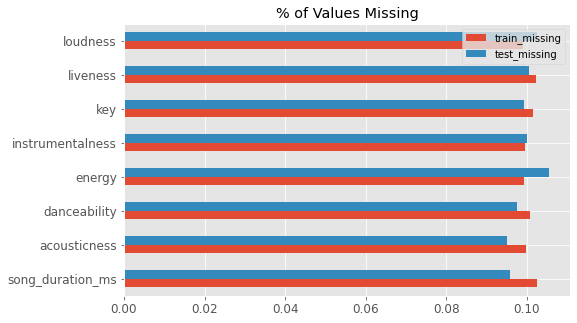

In [16]:
ncounts = pd.DataFrame([song.isna().mean(), song_test.isna().mean()]).T
ncounts = ncounts.rename(columns={0: "train_missing", 1: "test_missing"})

ncounts.query("train_missing > 0").plot(
    kind="barh", figsize=(8, 5), title="% of Values Missing"
)
plt.show()

In [17]:
# get indice names of ncounts
nacols = ncounts.query("train_missing > 0").index.values.tolist()

### How many missing values per observation?

In [18]:
tt["n_missing"] = tt[nacols].isna().sum(axis=1)
song["n_missing"] = song[nacols].isna().sum(axis=1)
song_test["n_missing"] = song_test[nacols].isna().sum(axis=1)

<AxesSubplot:title={'center':'Number of Missing Values per Sample'}>

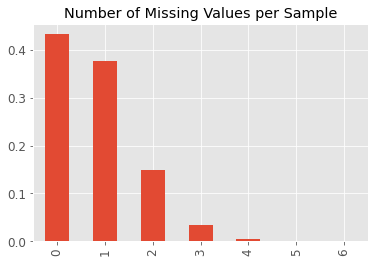

In [19]:
(tt["n_missing"].value_counts()/tt.shape[0]).plot(
    kind="bar", title="Number of Missing Values per Sample"
)

Do we see an imbalance in missing values when splitting by other features?

while we'r at it let's also check target imbalance

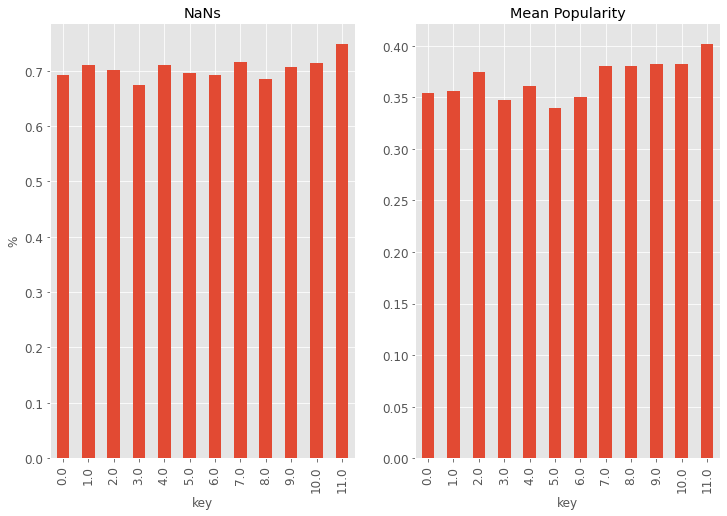

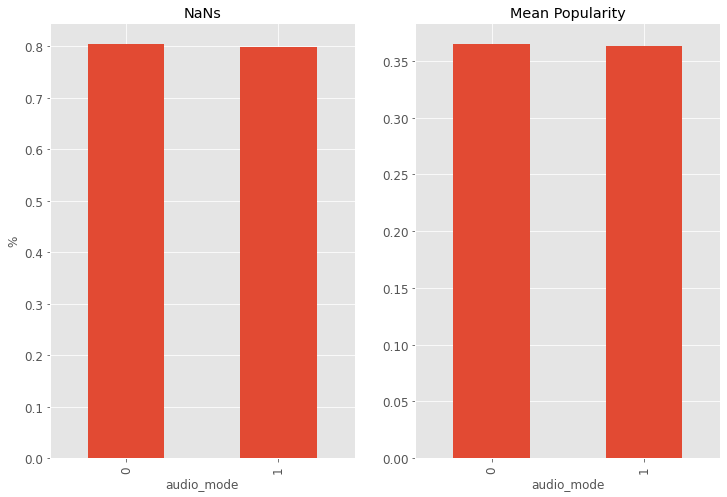

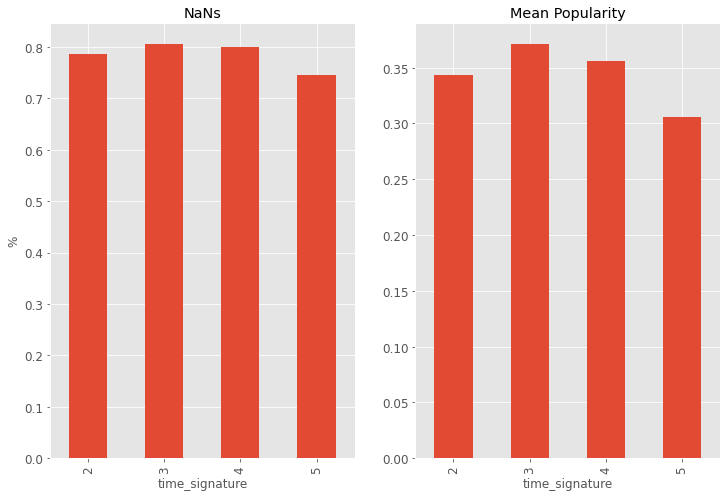

In [20]:
for col in categorical_cols:
    _, axs = plt.subplots(1, 2, figsize=(12, 8))
    tt.groupby(col)["n_missing"].mean().plot(kind="bar", ax=axs[0], ylabel="%", title='NaNs')
    tt.groupby(col)[col_y].mean().plot(kind="bar", ax=axs[1], title='Mean Popularity')

We find that:

* Not all features have missing values, though. We find them only in the first 8 columns (not counting the id). Consequently, those columns have around 10% missing values.

* There are some slight differences in the train vs test percentages of missing values for most features.

* overall there's more than 35% of records which has at least 1 missing feature

* there isn't much imbalance in missing values when splitting by features

## Feature transformations

In [21]:
# convert audio_mode, key & time_signature column values to categorical
song[categorical_cols] = song[categorical_cols].astype('category')
# get levels of categorical columns
song[categorical_cols].apply(lambda x: x.cat.categories)

key               Float64Index([0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6....
audio_mode                        Int64Index([0, 1], dtype='int64')
time_signature              Int64Index([2, 3, 4, 5], dtype='int64')
dtype: object

Try to predict the target using only missing value indicators as features

In [22]:
from sklearn.linear_model import LogisticRegressionCV
from sklearn.metrics import roc_auc_score

lr = LogisticRegressionCV(scoring="accuracy")

tt_missing_tag_df = tt[nacols].isna()
tt_missing_tag_df.columns = \
    [f"{c}_missing" for c in tt_missing_tag_df.columns]

tt = pd.concat([tt, tt_missing_tag_df], axis=1)

X_tmp = tt.query("isTrain")[
    [
        "song_duration_ms_missing",
        "acousticness_missing",
        "danceability_missing",
        "energy_missing",
        "instrumentalness_missing",
        "key_missing",
        "liveness_missing",
        "loudness_missing",
    ]
]

y_tmp = tt.query("isTrain")[col_y]

lr.fit(X_tmp, y_tmp)
lr.score(X_tmp, y_tmp)

preds = lr.predict_proba(X_tmp)[:, 0]

roc_auc_score(y_tmp, preds)

0.4928022710677621

## Data visualization - Individual Features

Things to take into consideration:
* different scales
* missing values
* log transformations needed for skewed

Candidates for transformations: spechiness, tempo, loudness, acoustiness, liveness, energry, danceability?

Normal ditibuted: song_duration



#### Discrete variables plots

In [23]:
#Checking out unique values in discrete variables
num_categorical = ['audio_mode', 'time_signature', 'key']
for i in num_categorical:
  print(f"{i}, {song[i].unique()} length: {len(song[i].unique())}")

audio_mode, [0, 1]
Categories (2, int64): [0, 1] length: 2
time_signature, [4, 3, 2, 5]
Categories (4, int64): [2, 3, 4, 5] length: 4
key, [10.0, 8.0, 5.0, 0.0, 4.0, ..., 2.0, 7.0, 1.0, 9.0, 11.0]
Length: 13
Categories (12, float64): [0.0, 1.0, 2.0, 3.0, ..., 8.0, 9.0, 10.0, 11.0] length: 13


In [24]:
cont_cols = ['song_duration_ms',	'acousticness',	'danceability',	'energy',	'instrumentalness',	'liveness',	'loudness',	'speechiness',	'tempo', 'audio_valence', 'instrumentalness - log']

In [25]:
song['instrumentalness - log'] = np.log(song['instrumentalness'])

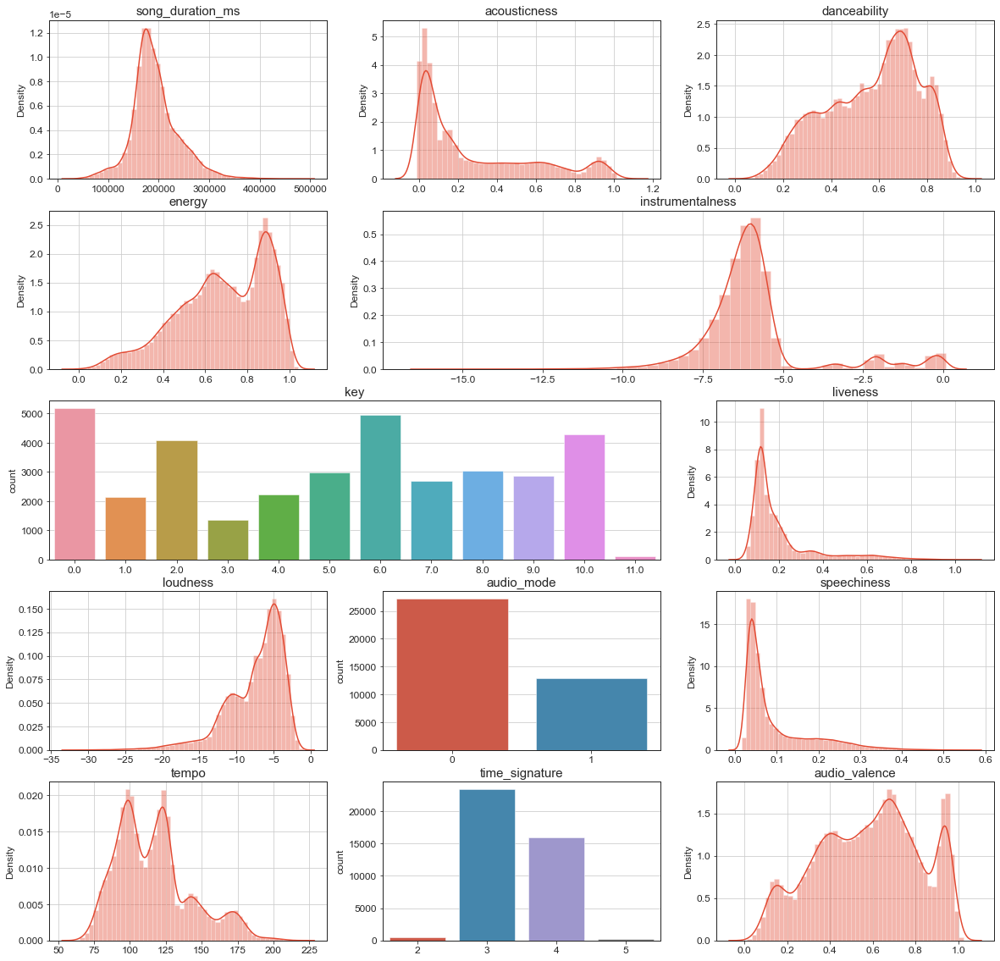

In [26]:
sns.set_style('ticks', {'axes.grid': True})

fig = plt.figure(figsize=(20,20))

axes = [plt.subplot2grid((5, 3), (0, 0)),
        plt.subplot2grid((5, 3), (0, 1)),
        plt.subplot2grid((5, 3), (0, 2)),
        plt.subplot2grid((5, 3), (1, 0)),
        plt.subplot2grid((5, 3), (1, 1), colspan=2),
        plt.subplot2grid((5, 3), (2, 0), colspan=2),
        plt.subplot2grid((5, 3), (2, 2)),
        plt.subplot2grid((5, 3), (3, 0)),
        plt.subplot2grid((5, 3), (3, 1)),
        plt.subplot2grid((5, 3), (3, 2)),
        plt.subplot2grid((5, 3), (4, 0)),
        plt.subplot2grid((5, 3), (4, 1)),
        plt.subplot2grid((5, 3), (4, 2))]

for i, variable in enumerate(FEATURES):
        if variable == 'instrumentalness':
            sns.distplot(np.log(song[variable]), ax=axes[i], kde=True)
        elif variable not in cont_cols:
            sns.countplot(x=variable, data=song, ax=axes[i])
        else:
            sns.distplot(song[variable], ax=axes[i], kde=True)
        axes[i].set_title(variable, fontsize=15)
        axes[i].set_xlabel('')

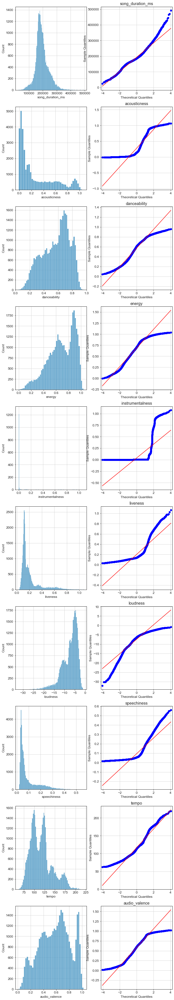

In [27]:
fig, axs = plt.subplots(len(numerical_cols), 2,
                        figsize=(10, len(song.columns)*4))

for i, col in enumerate(numerical_cols):
    sns.histplot(X[col], ax=axs[i, 0])
    sm.qqplot(X[col].dropna(), line="s", ax=axs[i, 1], fmt='b')
    axs[i, 1].set_title(col)

We find:

* Our initial impressions of the data types have largely been confirmed: `audio_mode` is a boolean feature, and time_signature and key are ordinal or categorical ones (or integer; although a better understanding of those musical concepts would certainly benefit from some domain knowledge.)

* A number of features are bounded between 0 and 1: `accosticness`, `danceability`, `energy`, `liveliness`, `speechiness`, and `audio_valence`.

* The feature `loudness` looks like it refer to the decibel scale.

* The distribution of `instrumentalness` is heavily right-skewed, and even after a log transform this feature doesn't look very well-behaved. This might need a bit more work.

* A Box-Cox transformation would be useful, especially for `loudness` and `song_duration_ms`

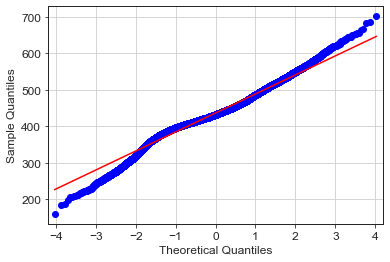

In [28]:
_ = sm.qqplot(
    X['song_duration_ms'].dropna().apply(
        lambda x: np.sqrt(x)),
    line="s", fmt='b'
)

The other columns seem to be outputs of sigmoid functions. If we apply the inverse sigmoid we should get the logits values. Then we can box-cox transform.

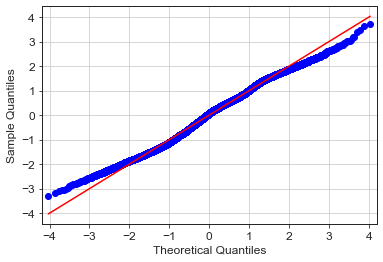

In [30]:
inv_sigmoid = lambda x: np.log(x / (1-x))

_ = sm.qqplot(
    power_transform(
        X[['danceability']].dropna().apply(inv_sigmoid)
    )[:, 0],
    line="s", fmt='b'
)

#### Target variable plot

It seems that we'are dealing with imbalanced, maybe some balancing should be in order. 

<AxesSubplot:xlabel='song_popularity', ylabel='count'>

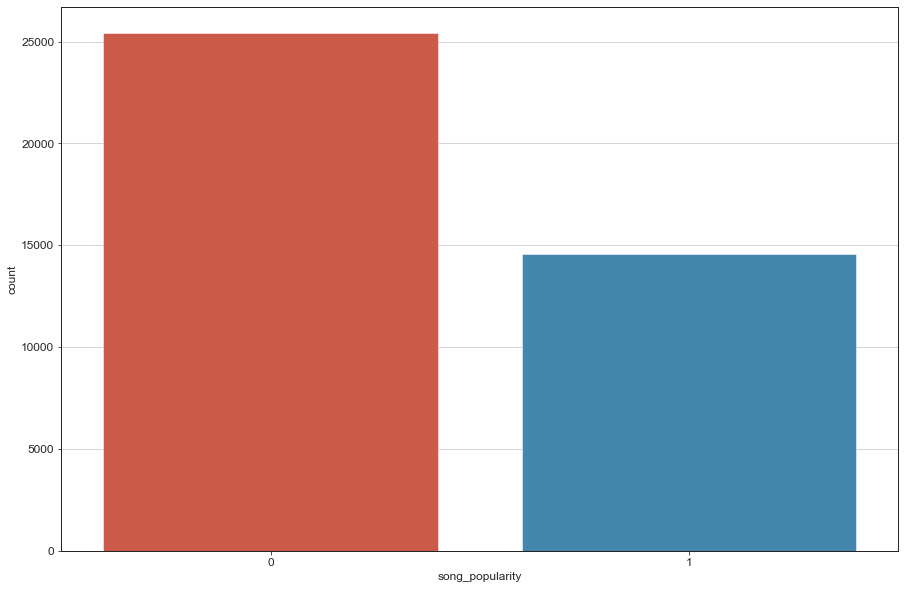

In [31]:
fig, ax = plt.subplots(figsize=(15,10))
sns.countplot(data=song, x=col_y)

There is a slight imbalance in the target distribution: a bit more than 60/40. Not super imbalanced, but something to keep in mind.


## Feature Interactions

After learning more about each individual feature, we now want to see them interacting with one another.

We will start with studying the impact of the target song_popularity on each individual feature, then look at correlations and relationships between the predictor features, before moving on to even higher dimensional relationships.

### Target Impact
We have seen all the feature distributions, now we want to investigate whether they look different based on the target value.

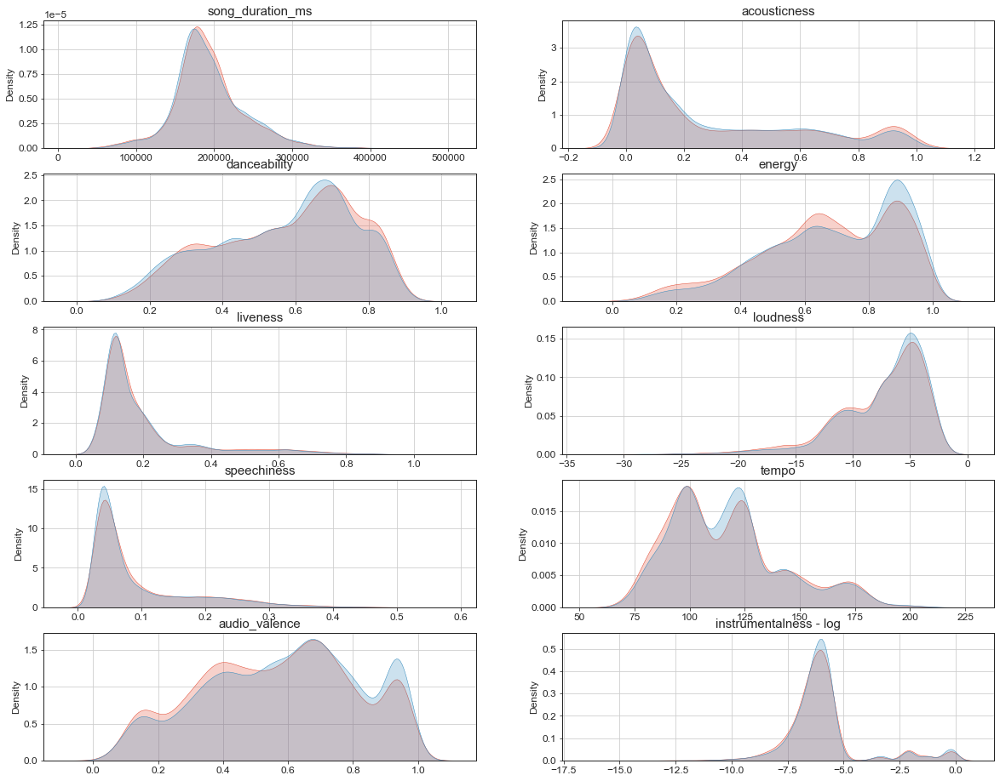

In [32]:
features = FEATURES.copy()
features.append('instrumentalness - log')
features.remove('instrumentalness')

sns.set_style('ticks', {'axes.grid': True})

fig = plt.figure(figsize=(20,16))

axes = [plt.subplot2grid((5, 2), (0, 0)),
        plt.subplot2grid((5, 2), (0, 1)),
        plt.subplot2grid((5, 2), (1, 0)),
        plt.subplot2grid((5, 2), (1, 1)),
        plt.subplot2grid((5, 2), (2, 0)),
        plt.subplot2grid((5, 2), (2, 1)),
        plt.subplot2grid((5, 2), (3, 0)),
        plt.subplot2grid((5, 2), (3, 1)),
        plt.subplot2grid((5, 2), (4, 0)),
        plt.subplot2grid((5, 2), (4, 1))]
i = 0
for variable in features:
        if variable not in num_categorical and variable != col_y:
                sns.kdeplot(song[variable][song[col_y] == True], ax=axes[i], fill = True)
                sns.kdeplot(song[variable][song[col_y] == False], ax=axes[i], fill=True)
                axes[i].set_title(variable, fontsize=15)
                axes[i].set_xlabel('')
                i += 1

There are no features that show strong differences in their distributions for popular vs unpopular songs. No smoking guns here.

Some features like `energy`, `audio_valence`, and perhaps `tempo` show some degree of difference between target classes. Others, like `song_duration_ms` or `liveness` appear to overlap almost perfectly.

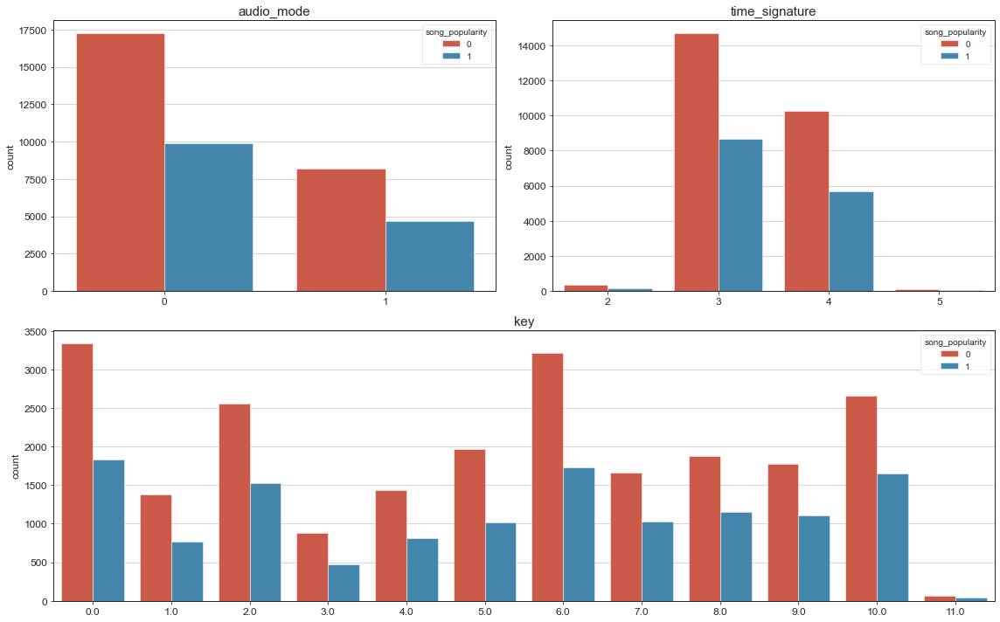

In [33]:
from matplotlib import patches as mpatches

fig = plt.figure(figsize=(16,10))

axes = [plt.subplot2grid((2, 2), (0, 0)),
        plt.subplot2grid((2, 2), (0, 1)),
        plt.subplot2grid((2, 2), (1, 0),  colspan=2)]

for i, variable in enumerate(['audio_mode', 'time_signature', 'key']):
        sns.countplot(x=variable, hue=col_y, data=song, ax=axes[i])
        axes[i].set_title(variable, fontsize=15)
        axes[i].set_xlabel('')

plt.tight_layout()
plt.show()

This kind of view does tell us as much, though, because the imbalance between popular and unpopular songs appears to be pretty universal for all realisations of all features. In order to see the relative percentages of song_popularity = 1 or 0 (or true vs false as we're expressing it here) we need to compute those fractions for every feature & value combination

In this 2nd step, we will only look at the percentage of popular songs (since the percentage of unpopular songs is uniquely determined by 1 - percentage of popular songs in a binary setting.):

### Predictor Feature Interactions

In [34]:
corr_matrix = X.corr()
corr_matrix

,song_duration_ms,acousticness,danceability,energy,instrumentalness,key,liveness,loudness,audio_mode,speechiness,tempo,time_signature,audio_valence
song_duration_ms,1.000000,-0.166443,-0.061929,0.148531,-0.024337,0.019354,0.033009,0.152954,-0.017211,-0.001236,0.085490,0.021609,-0.006948
acousticness,-0.166443,1.000000,-0.093737,-0.570177,0.072516,-0.186663,-0.124704,-0.532724,0.066973,-0.130244,-0.190964,-0.205307,-0.250310
danceability,-0.061929,-0.093737,1.000000,0.099933,-0.146447,0.120514,0.045400,0.200148,0.030289,0.177937,-0.089887,0.016455,0.384496
energy,0.148531,-0.570177,0.099933,1.000000,-0.120338,0.210176,0.154907,0.643931,-0.094916,0.120053,0.225465,0.238722,0.324626
instrumentalness,-0.024337,0.072516,-0.146447,-0.120338,1.000000,-0.054726,-0.033445,-0.181889,-0.003617,-0.053209,-0.010350,-0.047397,-0.157760
key,0.019354,-0.186663,0.120514,0.210176,-0.054726,1.000000,0.077046,0.201509,-0.036252,0.102993,0.053206,0.094144,0.132194
liveness,0.033009,-0.124704,0.045400,0.154907,-0.033445,0.077046,1.000000,0.146551,-0.013281,0.076612,0.064425,0.037766,0.084770
loudness,0.152954,-0.532724,0.200148,0.643931,-0.181889,0.201509,0.146551,1.000000,-0.076893,0.157550,0.173979,0.245403,0.356330
audio_mode,-0.017211,0.066973,0.030289,-0.094916,-0.003617,-0.036252,-0.013281,-0.076893,1.000000,0.019790,-0.023202,-0.043714,-0.015683
speechiness,-0.001236,-0.130244,0.177937,0.120053,-0.053209,0.102993,0.076612,0.157550,0.019790,1.000000,0.036192,0.035013,0.112558


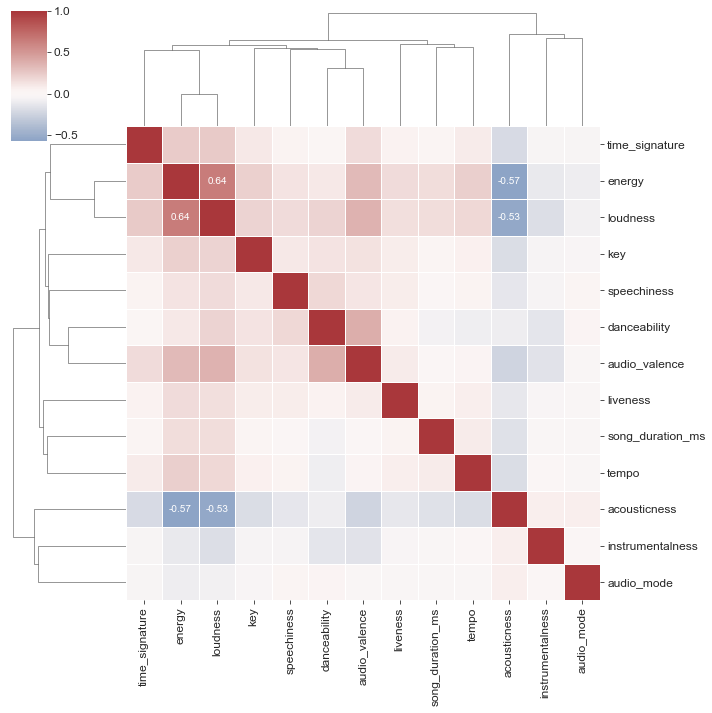

In [35]:
# fig, ax = plt.subplots(figsize=(20, 15))

labels = corr_matrix.applymap(lambda v: str(np.round(v, decimals=2)) if 1 > np.abs(v) >= .5 else '')
mask = np.zeros_like(corr_matrix)
mask[np.tril_indices_from(mask)] = True
sns.clustermap(corr_matrix, center=0, cmap='vlag', linewidth=1, annot=labels, fmt='')
# sns.heatmap(corr_matrix, cmap='RdBu', linewidth=1, annot=labels, mask=mask, square=True, fmt='')

We find:

* There's a strong anti-correlation between `acousticness` vs `energy` and `loudness`, respectively. Consequently, `energy` and `loudness` share a strong correlation.

* None of the features individually show a notable correlation with the target `song_popularity`.

### Categorical feature interactions

<AxesSubplot:xlabel='energy', ylabel='Density'>

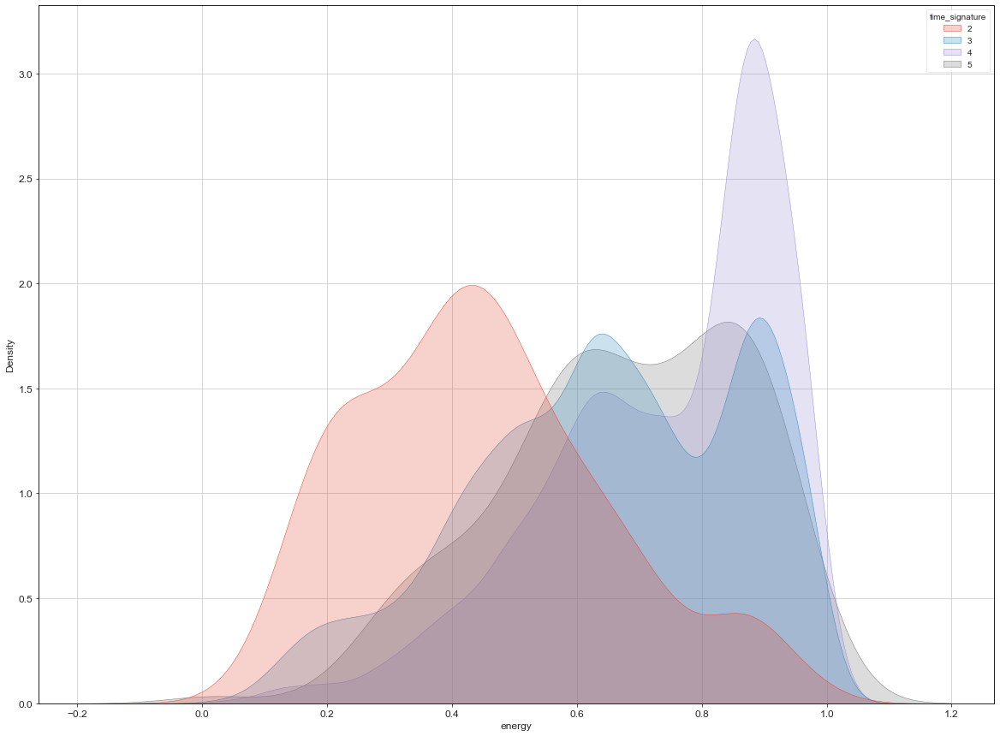

In [36]:
plt.figure(figsize=(20, 15))
sns.kdeplot('energy', hue='time_signature', data=song, fill=True, common_norm=False)

We find:

There are clear differences between the energy peaks for `time_signature = 2` vs `4`.

Smaller differences exist between the other values. `3` and `4` are the categories with the large numbers, and `4` is clearly more energetic than `3`.

<AxesSubplot:xlabel='key', ylabel='time_signature'>

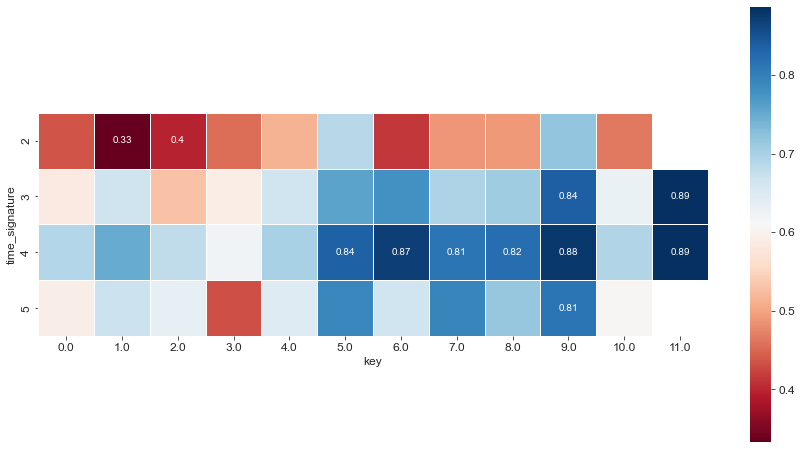

In [37]:
fig, ax = plt.subplots(figsize=(15, 8))

energy_O_key_at_time_signature = song.groupby(['key', 'time_signature']).median()['energy'].unstack().transpose()
labels = energy_O_key_at_time_signature.applymap(lambda v: str(np.round(v, decimals=2)) if np.abs(v) >= .8 or np.abs(v) <= .4 else '')
sns.heatmap(energy_O_key_at_time_signature, cmap='RdBu', linewidth=1, annot=labels, square=True, fmt='')

We find:

* For `time_signatures` `2` and `5` we have no instances of `key == 11`. This is no big surprise, since those three values are already rare individually, which makes their combinations even more rare.

* The lower keys and time signatures have less energy, on average, than the higher ones. In particular `key` 9 or 11.

### Contionus variables

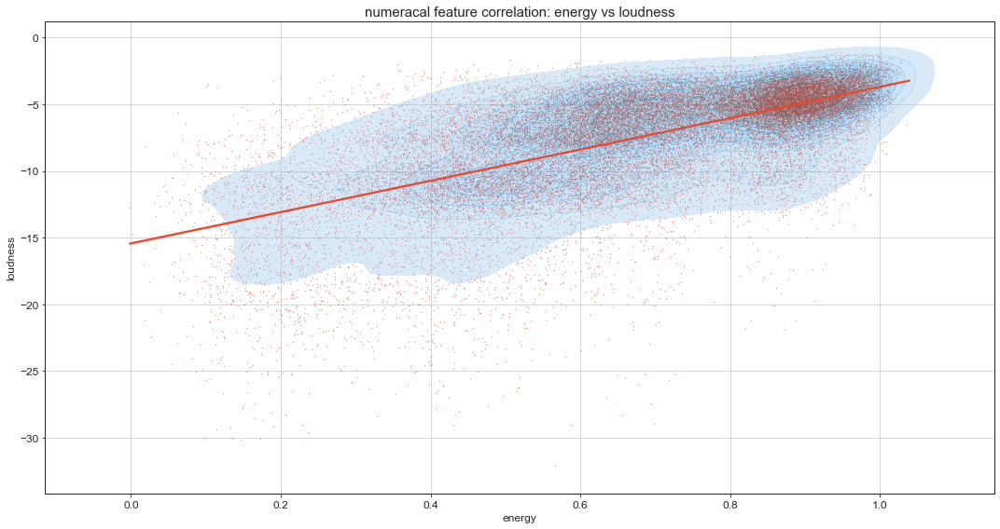

In [38]:
plt.figure(figsize=(15, 8))
ax = sns.regplot(x="energy", y="loudness", data=song, scatter=False)
plt.scatter(song["energy"], song["loudness"], s=1, alpha=.4, axes=ax)
sns.kdeplot(
    data=song, x="energy", y="loudness", fill=True, ax=ax, alpha=.4
)
ax.set_title('numeracal feature correlation: energy vs loudness', fontsize=15)
plt.tight_layout()
plt.show()

We find:

* The relationship looks pretty solid; not just built on outliers or strange.

* The 2 peaks of `energy` don't map 1:1 to the 2 peaks of `loudness` (which has a relatively similar distribution shape).

<Figure size 1080x576 with 0 Axes>

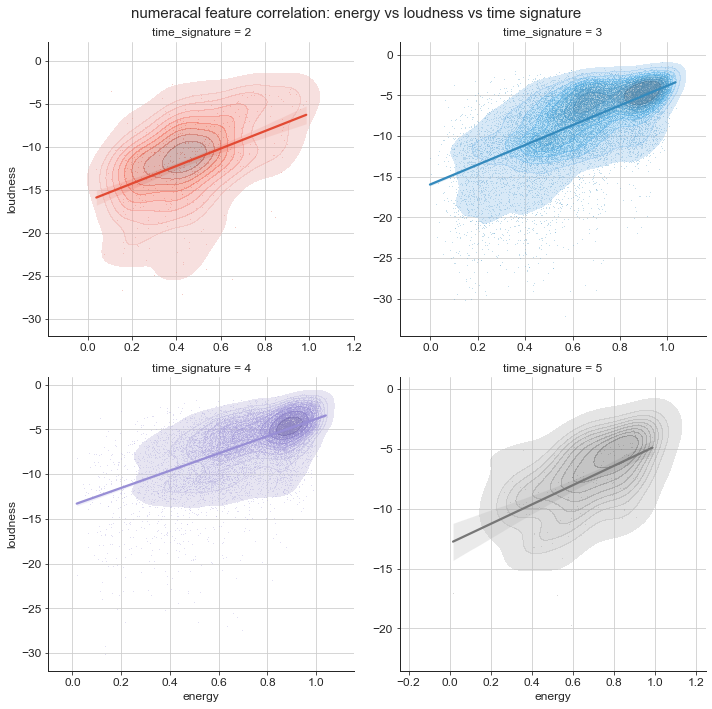

In [39]:
plt.figure(figsize=(15, 8))
ax = sns.FacetGrid(song, hue="time_signature", height=2.5, col_wrap=2, col="time_signature", sharex=False, sharey=False, size=5)
ax.map(sns.regplot, 'energy', 'loudness', scatter=False)
ax.map(sns.scatterplot, 'energy', 'loudness', alpha=.4, s=1)
ax.map(sns.kdeplot, 'energy', 'loudness', alpha=.4, fill=True)
ax.fig.suptitle('numeracal feature correlation: energy vs loudness vs time signature', fontsize=15)
plt.tight_layout()
plt.show()

We find:

* Other than the obvious sparsity of the samples with `key` 2 or 5, we see slightly different relations between the better populate 3 and 4 facets.

* The `key == 4` sample appears to have on average fewer values below -15

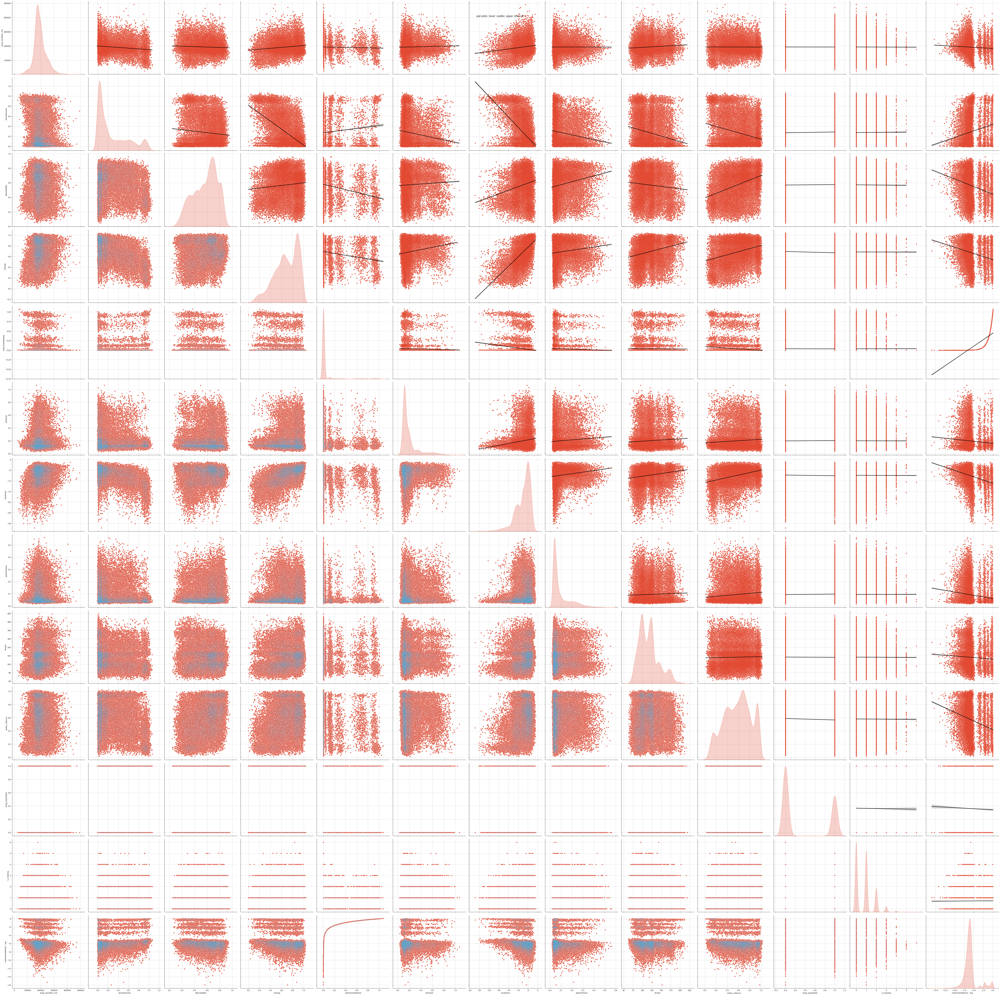

In [40]:
ax = sns.pairplot(song, diag_kind="kde", size=6)
ax.map_lower(sns.scatterplot, s=1, alpha=.4)
ax.map_upper(sns.regplot, line_kws={"color": "k"}, scatter_kws={"s": 1})
ax.fig.suptitle('pair plots: lower: scatter, upper: linear fit', fontsize=15)
plt.tight_layout()
plt.show()

We find:

* We've already seen the correlation strengths in the corrplot, and we know the distribution shapes from previous visuals.

* In the scatter facets, there's not much that calls for additional exploration. Most relations represent a pretty direct superposition of their 2 contributing feature distributions (and, for instance, their multi-peak structure).

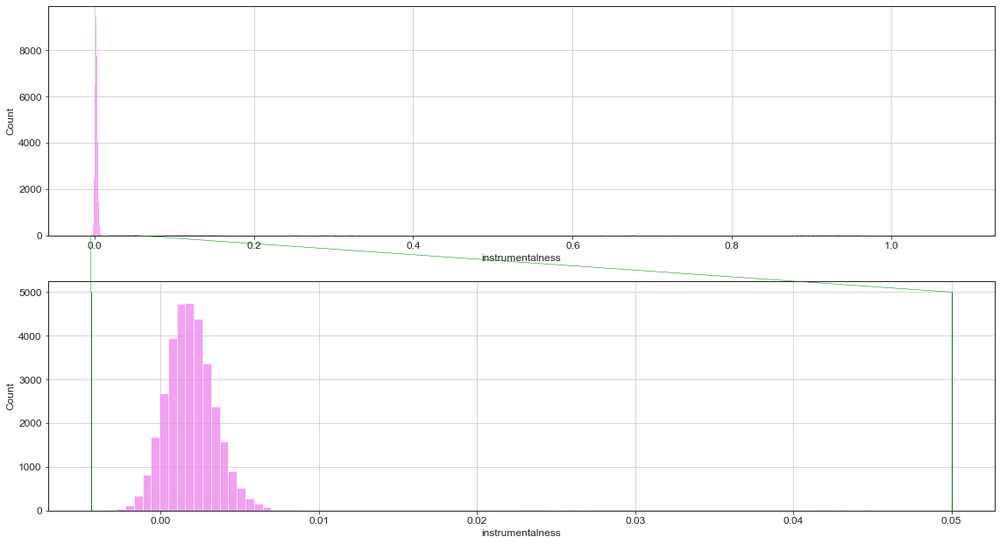

In [41]:
from matplotlib.patches import ConnectionPatch

# zoom in on instrumentalness
fig = plt.figure(figsize=(15, 8))
plt.subplots_adjust(bottom = 0., left = 0, top = 1., right = 1)
sub1 = fig.add_subplot(2,1,1)
sub1 = sns.histplot(song['instrumentalness'], kde=False, bins=1000, color='violet')

sub2 = fig.add_subplot(2,1,2) # two rows, two columns, second cell
sub2 = sns.histplot(song['instrumentalness'][song['instrumentalness'] < .05], kde=False, bins=100, color='violet')
plt.vlines([np.min(song['instrumentalness']), .05], 0, 5000, color='green', linewidth=1, axes=sub2)
con1 = ConnectionPatch(xyA=(0.05, 0), coordsA=sub1.transData, 
                       xyB=(.05, 5000), coordsB=sub2.transData, color = 'green')
fig.add_artist(con1)
con2 = ConnectionPatch(xyA=(np.min(song['instrumentalness']), 0), coordsA=sub1.transData, 
                       xyB=(np.min(song['instrumentalness']), 5000), coordsB=sub2.transData, color = 'green')
fig.add_artist(con2)

We find:

* This is a useful result, because it points towards a relatively well behaved part of the distribution below 0.01.

* We know that there are other values above that threshold of 0.01, so let's count both groups:

In [42]:
inst = (song['instrumentalness'][~song['instrumentalness'].isnull()] < .01).value_counts()
inst = pd.DataFrame({'subset': ['main_subset', 'side_subset'], 'n': inst, 'percentage': inst/inst.sum()})
inst.reset_index(inplace=True)
inst

,index,subset,n,percentage
0,True,main_subset,32763,0.909704
1,False,side_subset,3252,0.090296


About 91% of `instrumentalness` has values below 0.01 and fall into the "main distribution". The remaining 9% are above that threshold and we will call that the "side distribution".

That's enough sample size (in the side distribution) to plot both parts of `instrumentalness` next to each other, but in separate facets so that the presence of one distribution doesn't make it harder to see the other one. We'll also add some target impact while we're at it:

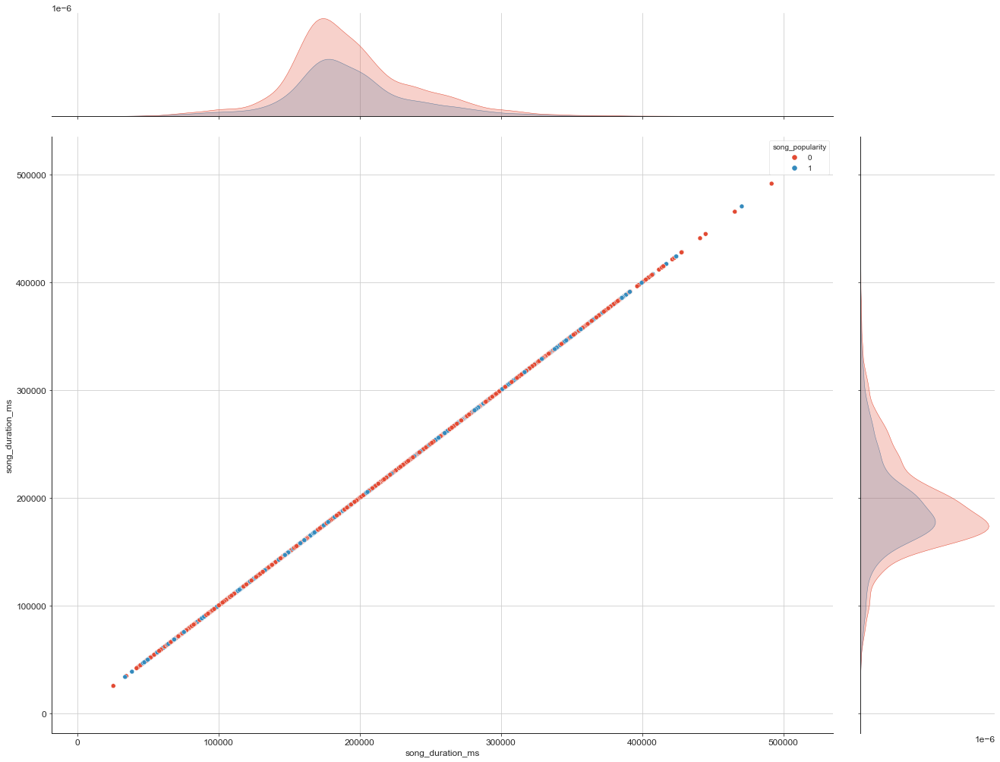

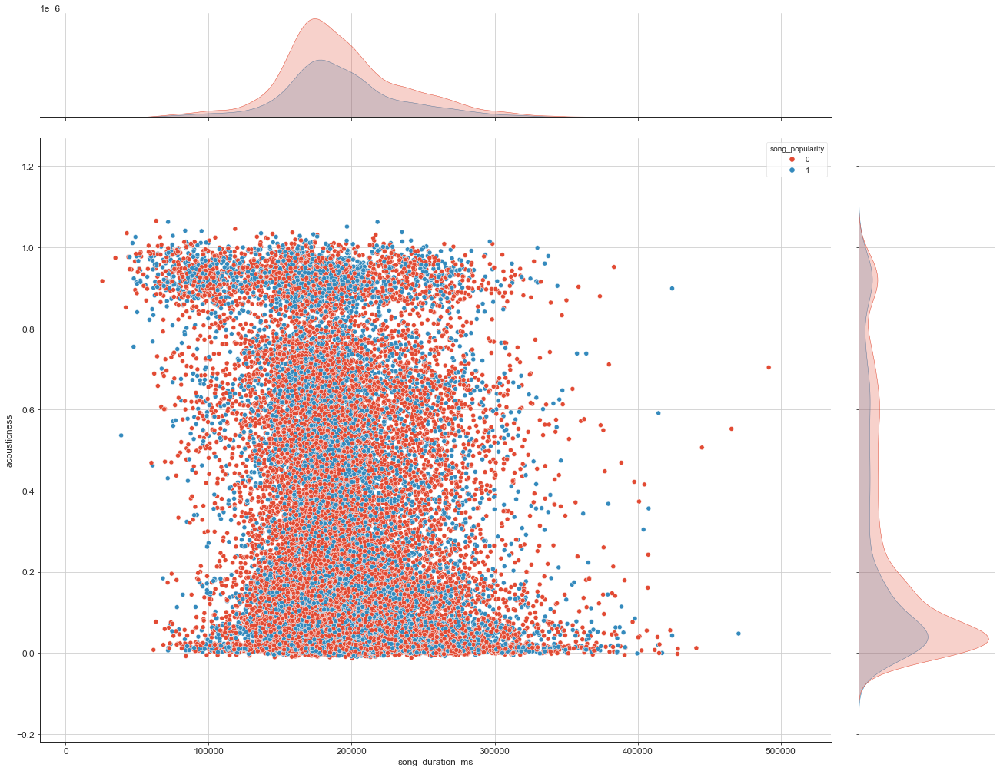

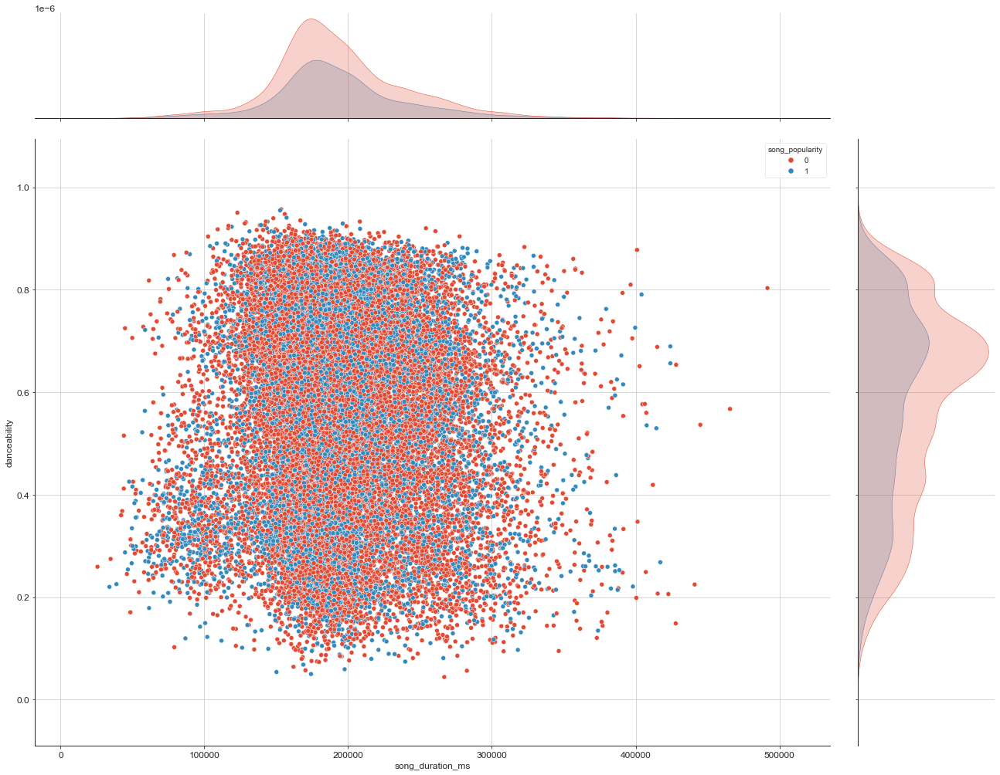

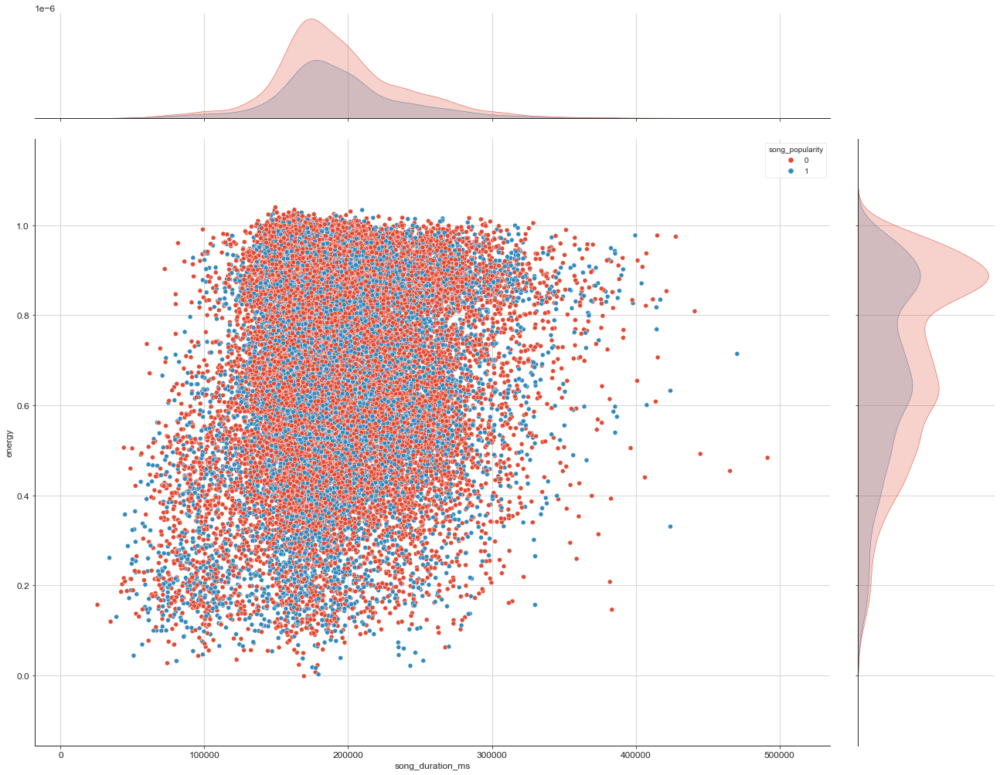

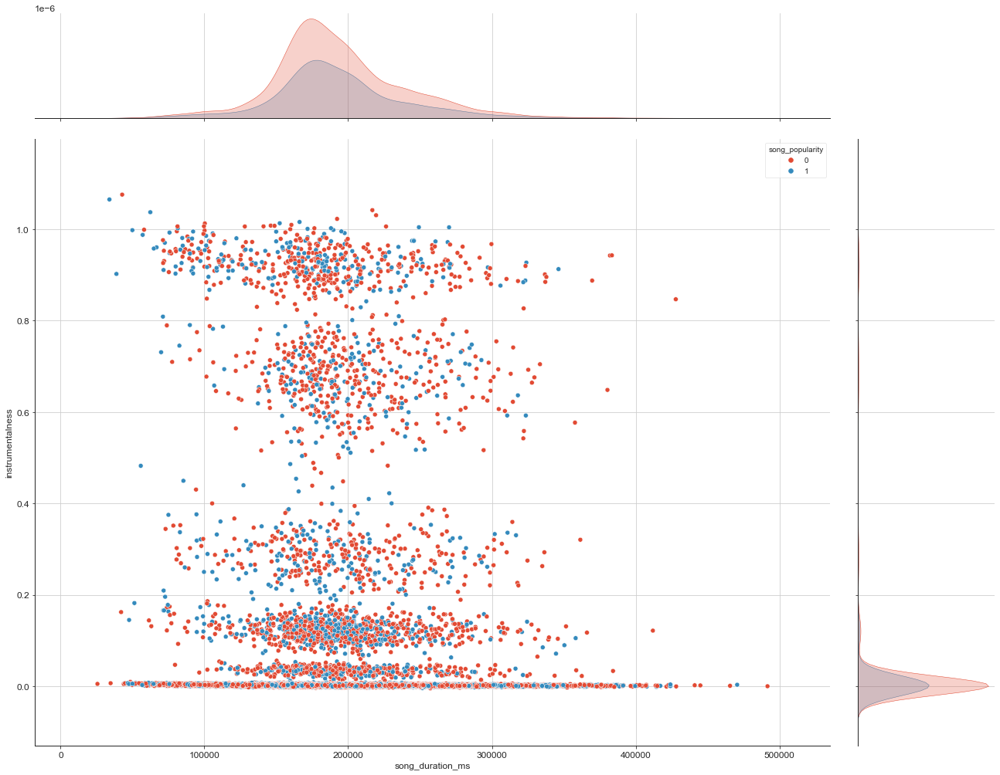

...

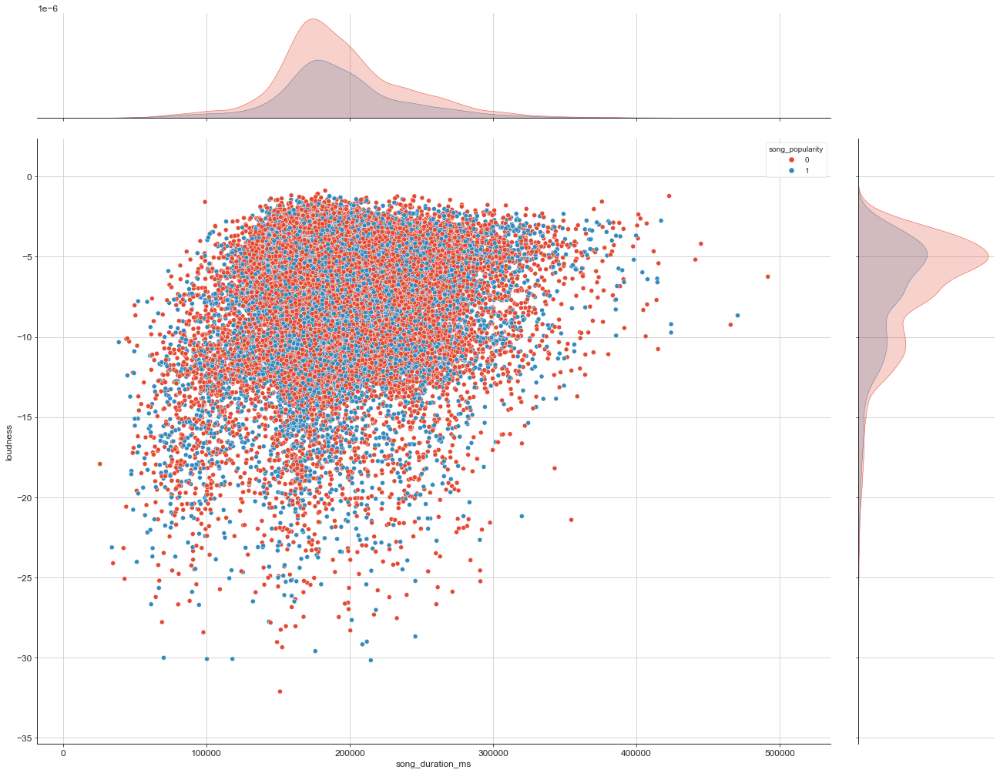

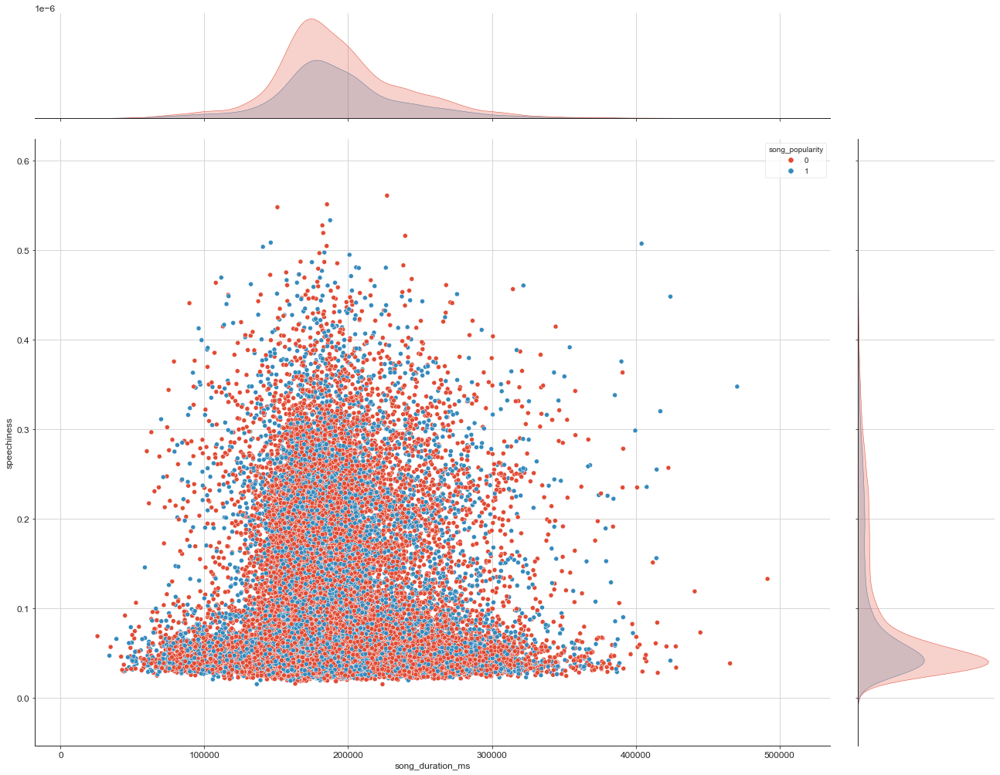

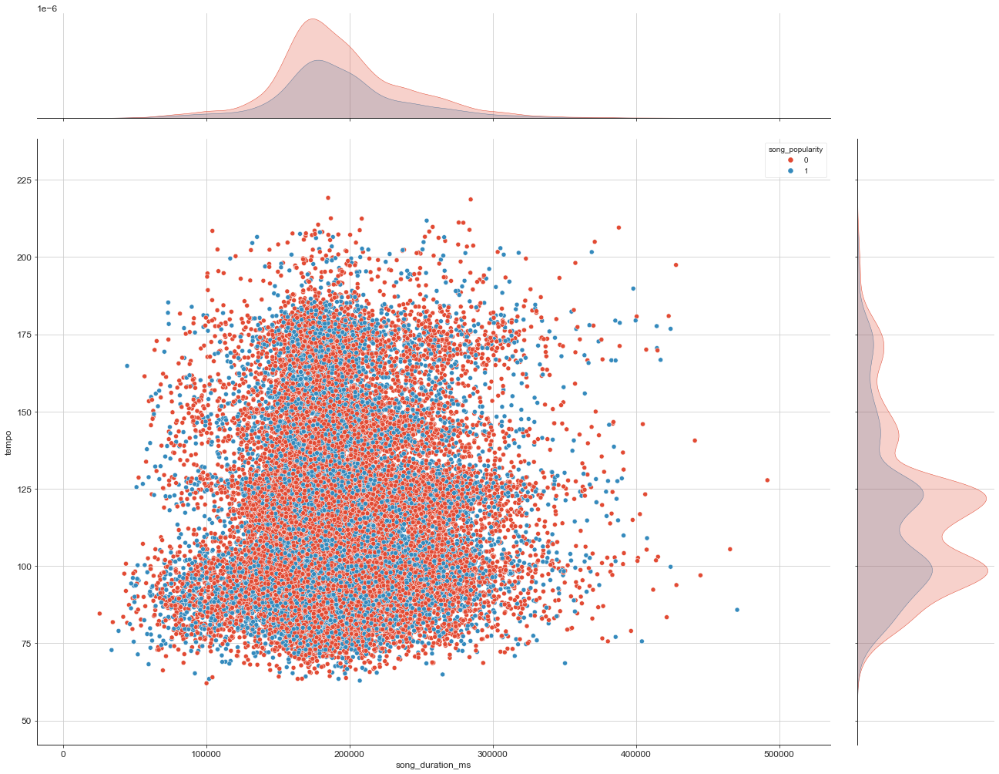

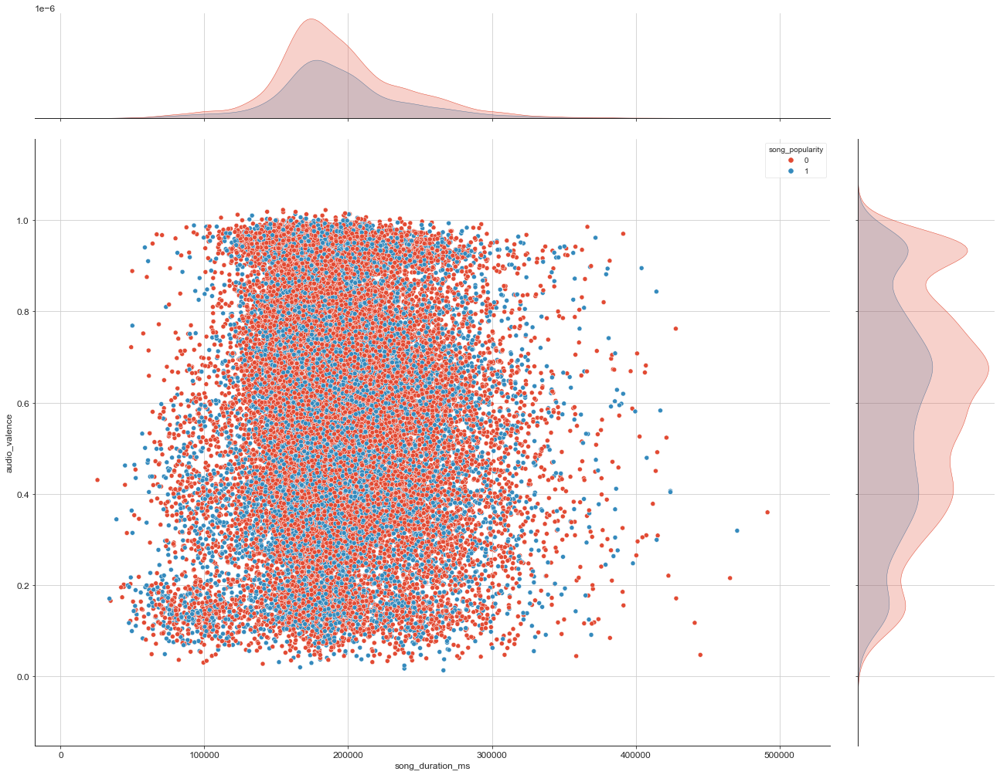

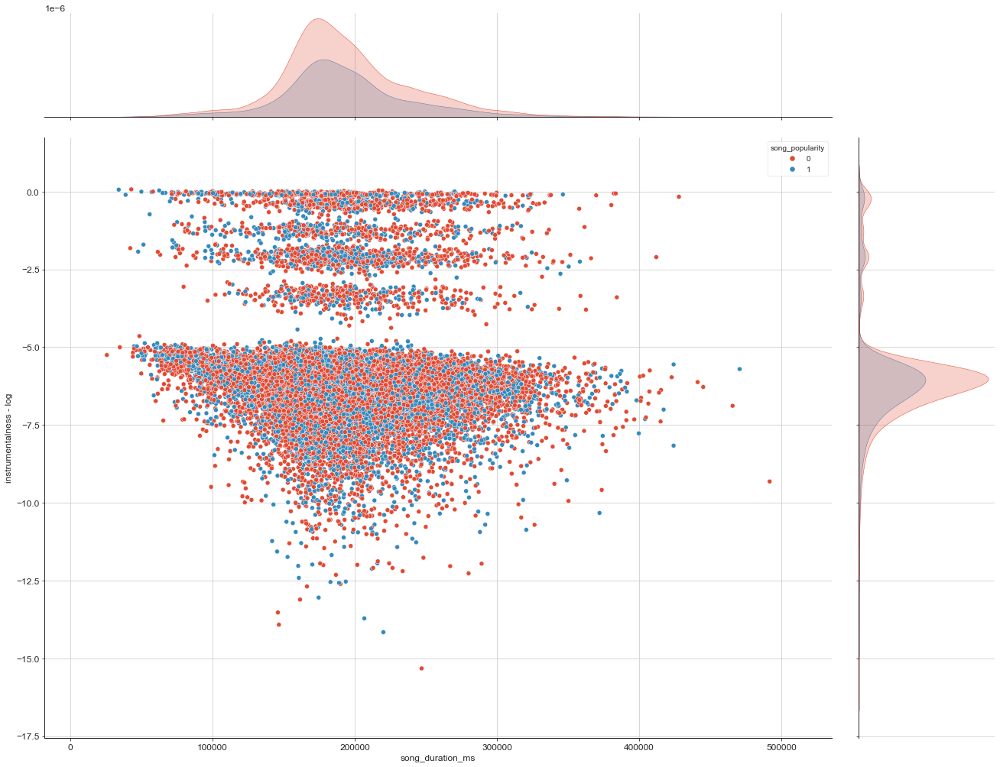

In [43]:
for i in cont_cols:
  sns.jointplot(data=song, y=i, x='song_duration_ms', hue=col_y)
  plt.gcf().set_size_inches(20,15)


Maybe instrumentalness should be tansformed into discrete variables? Or categorical variable?

## On the hunt for outliers

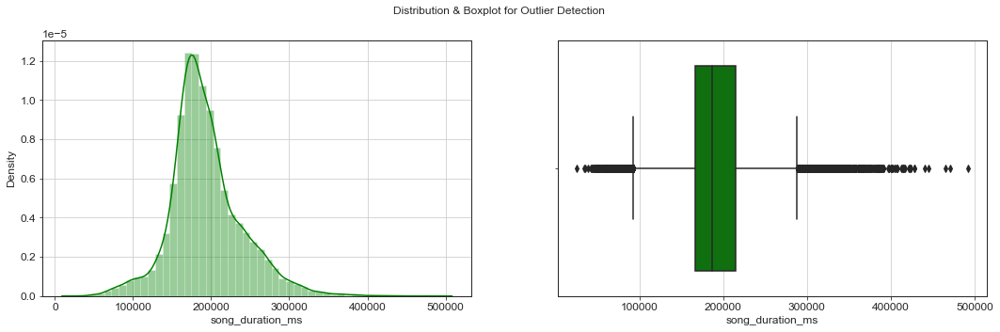

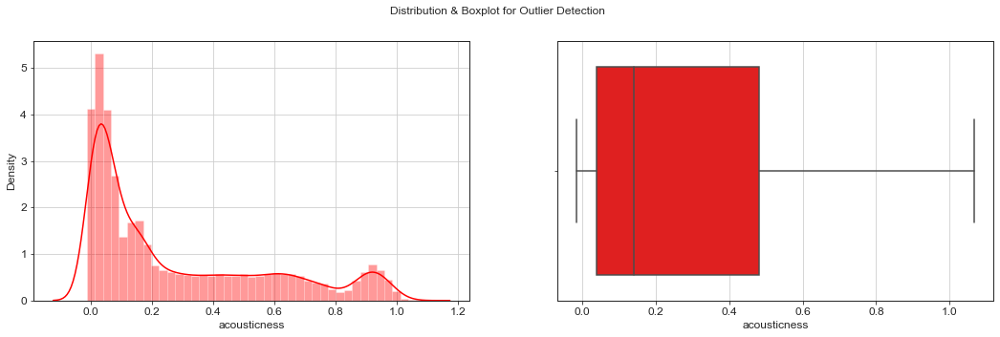

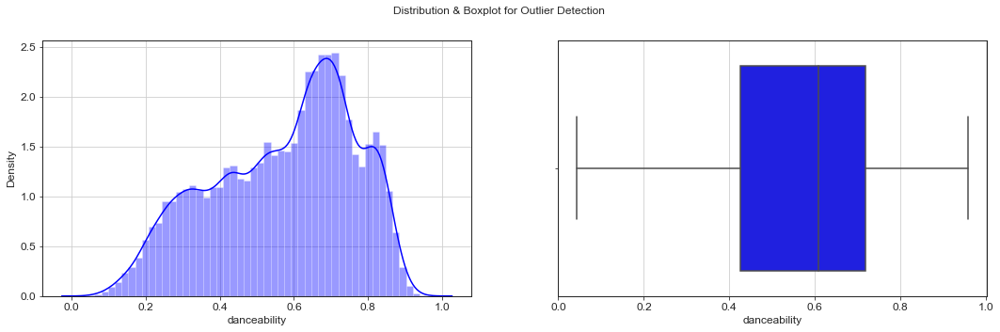

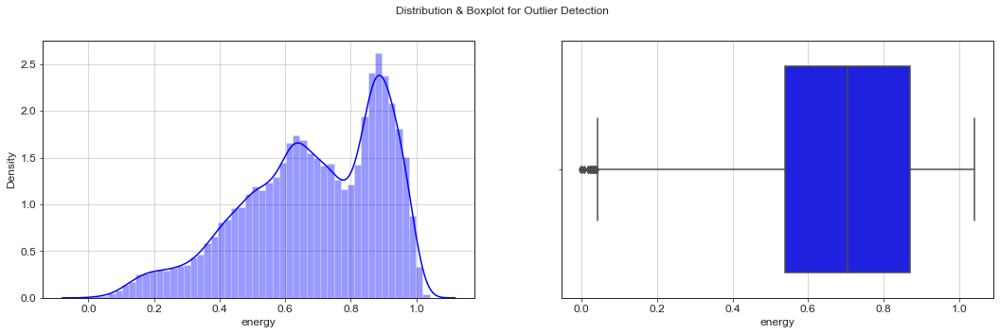

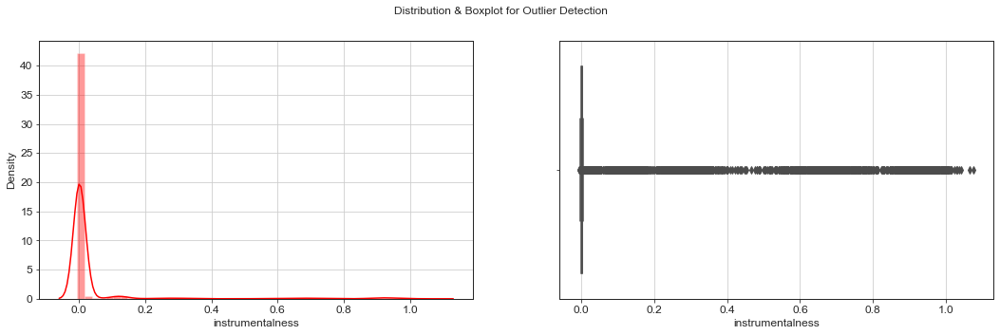

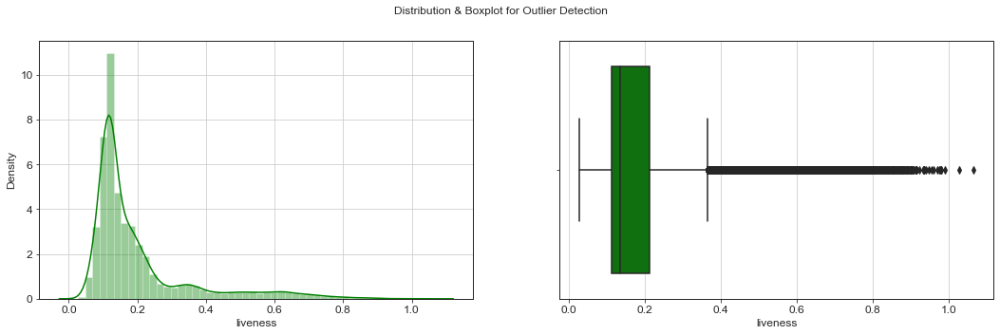

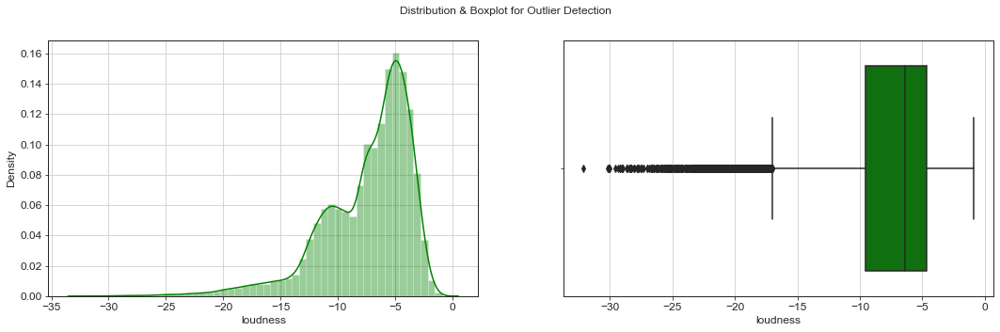

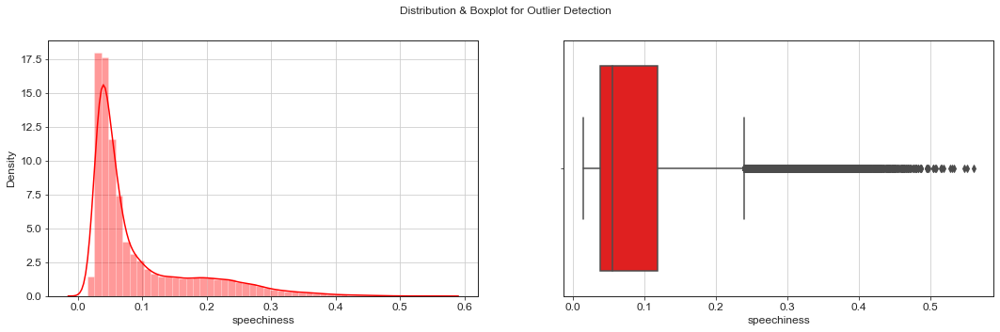

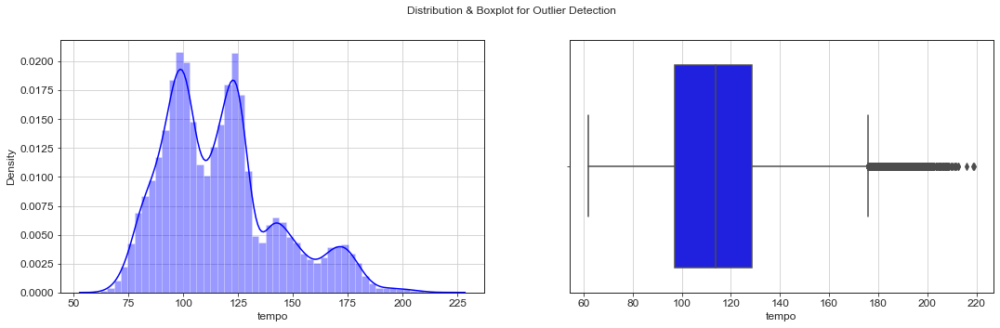

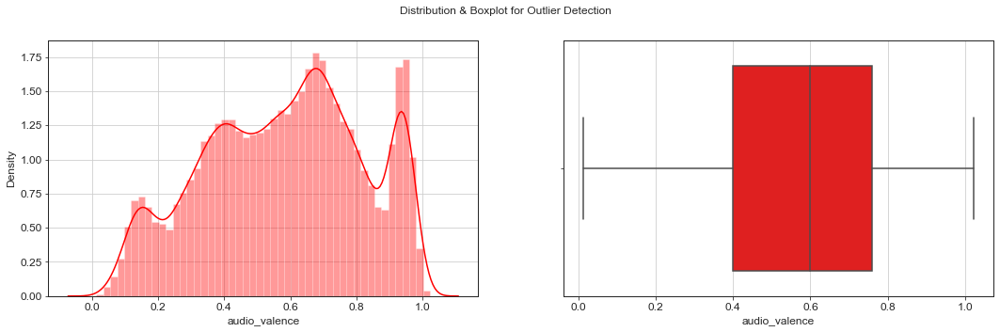

In [44]:
def outlier_viz(col):
    color = random.choice(['r', 'g', 'b'])
    fig, ax = plt.subplots(1,2,figsize=(18,5))
    sns.distplot(col, ax=ax[0], color=color)
    sns.boxplot(col, ax=ax[1], color=color)
    plt.suptitle('Distribution & Boxplot for Outlier Detection')
    fig.show()
    return None

num = ['song_duration_ms', 'acousticness', 'danceability', 'energy',
       'instrumentalness', 'liveness', 'loudness','speechiness', 'tempo', 'audio_valence']

for i in num:
    outlier_viz(song[i])

## Feature Engineering

### imputing na values

#### Simple Imputer

In [45]:
simple_mean_imptr = SimpleImputer(strategy="mean", add_indicator=False)
tr_simple_imp = simple_mean_imptr.fit_transform(X_train[FEATURES])
tr_simple_imp = pd.DataFrame(tr_simple_imp, columns=FEATURES)

#### [Iterative Imputer!](https://scikit-learn.org/stable/modules/generated/sklearn.impute.IterativeImputer.html)

Multivariate imputer that estimates each feature from all the others.

A strategy for imputing missing values by modeling each feature with missing values as a function of other features in a round-robin fashion.

Uses by default the BayesianRidge model to impute

In [46]:
%%time
it_imputer = IterativeImputer(max_iter=10)
train_iterimp = it_imputer.fit_transform(X_train[FEATURES])
train_iterimp = pd.DataFrame(train_iterimp, columns=FEATURES)

Wall time: 3.18 s


#### [KNN Imputer](https://scikit-learn.org/stable/modules/generated/sklearn.impute.KNNImputer.html)

Imputation for completing missing values using k-Nearest Neighbors.

In [47]:
%%time

knn_imptr = KNNImputer(n_neighbors=1)
train_knnimp = knn_imptr.fit_transform(X_train[FEATURES])
train_knnimp = pd.DataFrame(train_knnimp, columns=FEATURES)

Wall time: 1min 19s


#### [LightGBM Imputer!!](https://github.com/analokmaus/kuma_utils/blob/master/preprocessing/imputer.py)

In [48]:
# !rm -r kuma_utils
!pip install lightgbm
# !git clone https://github.com/analokmaus/kuma_utils.git

In [49]:
sys.path.append("kuma_utils/")
from kuma_utils.preprocessing.imputer import LGBMImputer

In [50]:
%%time
lgbm_imtr = LGBMImputer(n_iter=100, verbose=True)

train_lgbmimp = lgbm_imtr.fit_transform(X_train[FEATURES])
train_lgbmimp = pd.DataFrame(train_lgbmimp, columns=FEATURES)

song_duration_ms:	regression...iter100/100
acousticness:	regression...iter100/100
danceability:	regression...iter18/100
energy:	regression...iter100/100
instrumentalness:	regression...iter100/100
key:	regression...iter100/100
liveness:	regression...iter100/100
loudness:	regression...iter100/100
Wall time: 21.4 s


#### Check The Imputation Distribution

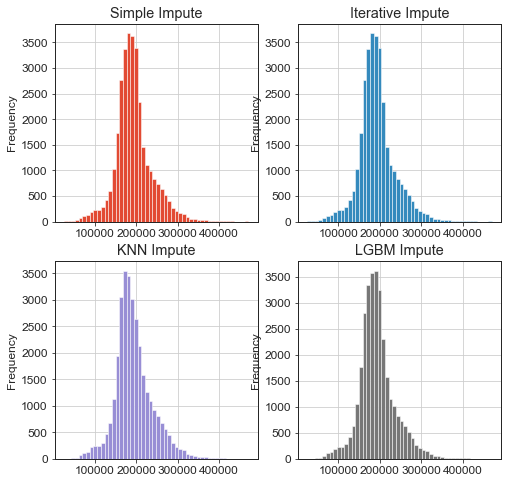

In [51]:
fig, axs = plt.subplots(2, 2, figsize=(8, 8))
axs = axs.flatten()
color_pal = plt.rcParams['axes.prop_cycle'].by_key()['color']

train_iterimp['song_duration_ms'] \
    .plot(kind='hist',
          bins=50,
          ax=axs[0],
          title='Simple Impute',
         color=color_pal[0])

train_iterimp['song_duration_ms'] \
    .plot(kind='hist',
          bins=50,
          ax=axs[1],
          title='Iterative Impute',
         color=color_pal[1])

train_knnimp['song_duration_ms'] \
    .plot(kind='hist',
          bins=50,
          ax=axs[2],
          title='KNN Impute',
         color=color_pal[2])

train_lgbmimp['song_duration_ms'] \
    .plot(kind='hist',
          bins=50,
          ax=axs[3],
          title='LGBM Impute',
         color=color_pal[3])
plt.show()

### handeling outliers

In [52]:
# columns used for inverse sigmoid transformation
col_sig = [
    'acousticness',
    'danceability',
    'energy',
    'instrumentalness',
    'liveness',
    'speechiness',
    'audio_valence',
]

col_pow = [
    'song_duration_ms',
    'tempo',
]

def scale_data(X):
    inv_sigmoid = lambda x: np.log(x / (1-x))
    
    X = X.copy()
    for col in col_sig:
        X[col] = minmax_scale(X[col], feature_range=(0+1e-6, 1-1e-6))
        X[col] = X[col].apply(inv_sigmoid)
    # Box-Cox transformation
    X[col_pow+col_sig] = power_transform(X[col_pow+col_sig])
    X['loudness'] = X['loudness'].apply(lambda x: np.log1p(-x))
    return X
    
X_train_processed = scale_data(train_lgbmimp)

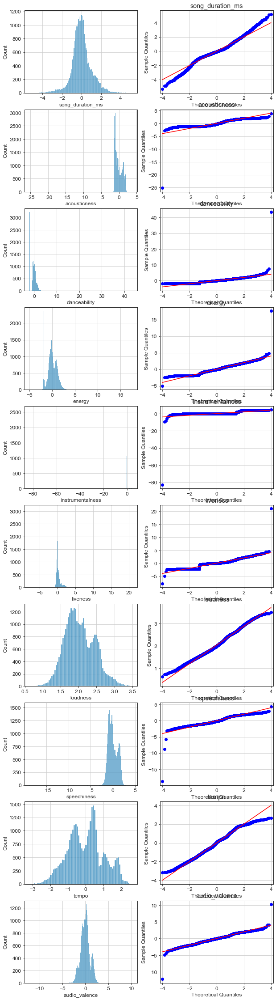

In [53]:
fig, axs = plt.subplots(len(numerical_cols), 2,
                        figsize=(10, len(numerical_cols)*4))

for i, col in enumerate(numerical_cols):
    sns.histplot(X_train_processed[col], ax=axs[i, 0])
    sm.qqplot(X_train_processed[col].dropna(), line="s", ax=axs[i, 1], fmt='b')
    axs[i, 1].set_title(col)

<class 'pandas.core.series.Series'> <class 'pandas.core.series.Series'>


AttributeError: 'numpy.ndarray' object has no attribute 'hist'

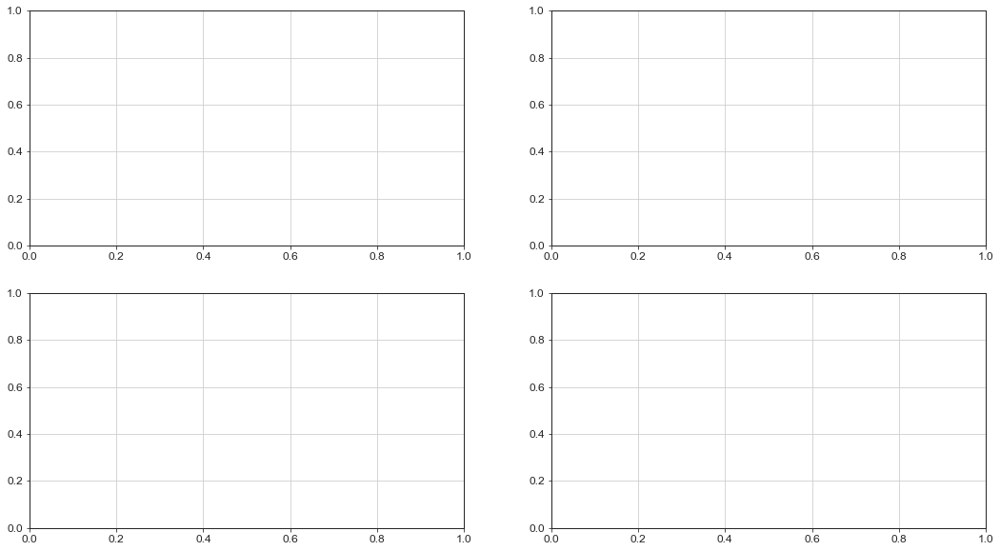

In [55]:
#! todo
def outlier_comparison_viz(col_unproc, col_proc):
    color = random.choice(['r', 'g', 'b'])
    fig, ax = plt.subplots(2,2,figsize=(18,10))
    print(type(col_unproc), type(col_proc))
    sns.distplot(col_unproc, ax=ax[0], color=color)
    sns.boxplot(col_unproc, ax=ax[2], color=color)
    sns.distplot(col_proc, ax=ax[1], color=color)
    sns.boxplot(col_proc, ax=ax[3], color=color)
    plt.suptitle('Distribution & Boxplot before and after outlier preprocessing')
    fig.show()
    return None

X_train_tmp = pd.DataFrame(X_train, columns=FEATURES)
X_train_proc_tmp = pd.DataFrame(X_train_processed, columns=FEATURES)

for i in numerical_cols:
    outlier_comparison_viz(X_train_tmp[i], X_train_proc_tmp[i])

In [ ]:
# song['song_duration_s'] =(song['song_duration_ms'] / 1000).astype('int32')
song['acoust']          = song['acousticness'].apply(lambda x:1 if x > 0.5 else 0)
song['dance']           = song['danceability'].apply(lambda x:1 if x > 0.5 else 0)
song['energetic']       = song['energy'].apply(lambda x:1 if x>0.5 else 0)
song['instrumental']    = song['instrumentalness'].apply(lambda x:1 if x>0.1 else 0)
song['live']            = song['liveness'].apply(lambda x:1 if x>0.2 else 0)
song['loud']            = song['loudness'].apply(lambda x:1 if x > -13 else 0)
song['speech']          = song['speechiness'].apply(lambda x:1 if x>0.25 else 0)
song['loud_energy']     = song['loudness'] / song['energy']
# song['loud_energy']     = song['loud_energy'].apply(lambda x:int(abs(x)))
song['tempo_dance']     = song['tempo'] / song['danceability']
# song['tempo_dance']     = song['tempo_dance'].astype('int32')
song['energy_acoust']   = song['energy'] / song['acousticness']
song['loud_acoust']     = song['loudness'] / song['acousticness']
song['dance_audval']    = song['danceability'] / song['audio_valence']

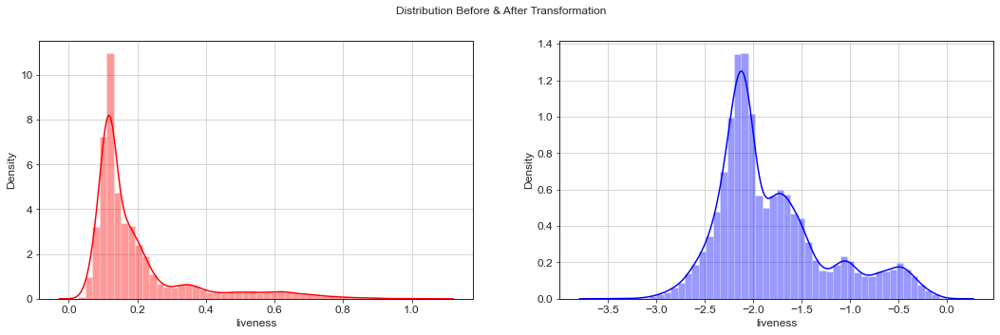

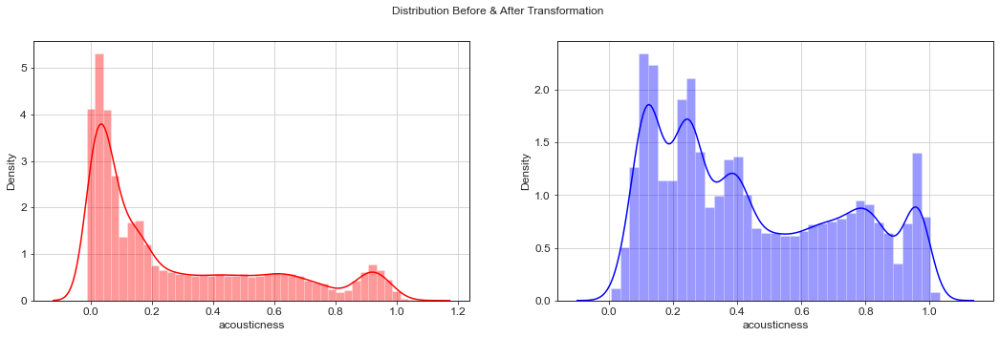

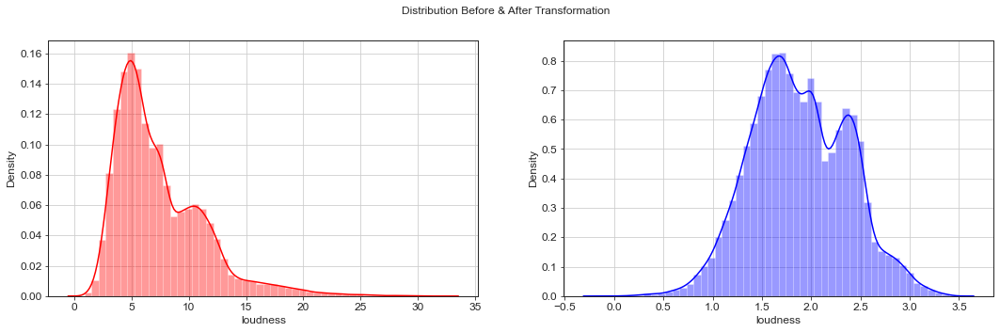

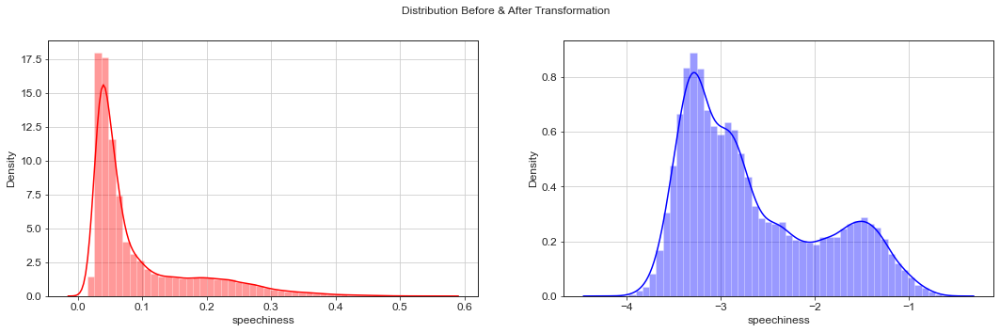

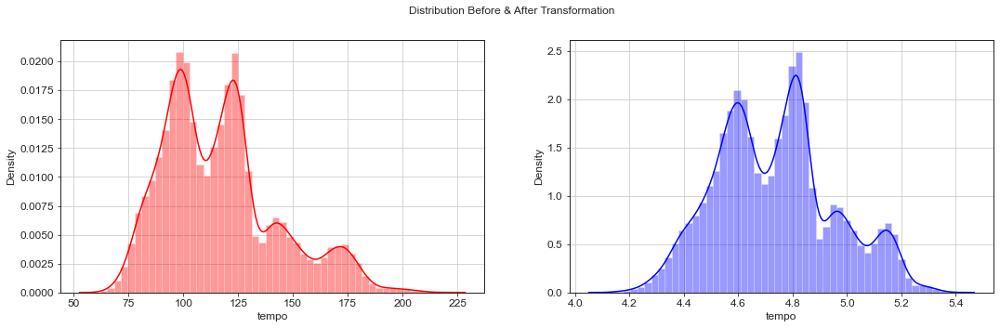

In [ ]:
def transformation(df, col, apply='log'):
    fig, ax = plt.subplots(1,2,figsize=(18,5))
    sns.distplot(df[col], ax=ax[0], color='r')
    if apply == 'log':
        df[col] = np.log(df[col])
    elif apply == 'sqrt':
        df[col] = np.sqrt(df[col])
    sns.distplot(df[col], ax=ax[1], color='b')
    plt.suptitle('Distribution Before & After Transformation')
    return None

song['loudness'] = abs(song['loudness'])
transformation(song, 'liveness', 'log')
transformation(song, 'acousticness', 'sqrt')
transformation(song, 'loudness', 'log')
transformation(song, 'speechiness', 'log')
transformation(song, 'tempo', 'log')

# song.drop('instrumentalness', axis=1, inplace=True)

In [96]:
attribute_description = [    
    'The duration of the track in milliseconds.',

    'A confidence measure from 0.0 to 1.0 of whether the track is acoustic.',
    
    'Describes how suitable a track is for dancing based on a combination of musical elements including tempo, rhythm stability, beat strength, and overall regularity.',

    'Represents a perceptual measure of intensity and activity. Typically, energetic tracks feel fast, loud, and noisy. For example, death metal has high energy, while a Bach prelude scores low on the scale.',

    'Predicts whether a track contains no vocals. "Ooh" and "aah" sounds are treated as instrumental in this context. Rap or spoken word tracks are clearly "vocal".',

    'The estimated overall key of the track. Integers map to pitches using standard Pitch Class notation . E.g. 0 = C, 1 = C♯/D♭, 2 = D, and so on.',
    
    'Detects the presence of an audience in the recording. Higher liveness values represent an increased probability that the track was performed live.',

    'The overall loudness of a track in decibels (dB). Loudness values are averaged across the entire track and are useful for comparing relative loudness of tracks.',

    'Indicates the modality (major or minor) of a track, the type of scale from which its melodic content is derived. Major is represented by 1 and minor is 0.',

    'This detects the presence of spoken words in a track. The more exclusively speech-like the recording (e.g. talk show, audio book, poetry), the closer to 1.0 the attribute value.',
    
    'The overall estimated tempo of a track in beats per minute (BPM). In musical terminology, tempo is the speed or pace of a given piece, and derives directly from the average beat duration.',

    'An estimated overall time signature of a track. The time signature (meter) is a notational convention to specify how many beats are in each bar (or measure).',

    'Describes the musical positiveness conveyed by a track. Tracks with high valence sound more positive (e.g. happy, cheerful, euphoric), while tracks with low valence sound more negative (e.g. sad, depressed, angry).'
    ]

for i, (column, description) in enumerate(zip(song.columns[:-3], attribute_description)):
    if column in categorical_cols.values:
        attribute_description[i] += f'\n levels: {song[column].nunique()}'

data_dict = pd.DataFrame({'Data Type': song.dtypes[:-3], 'Description': attribute_description})
data_dict.to_csv('../reports/figures/data-dict.csv')
# attribute_description

In [114]:
descriptive_stats = song.describe()[numerical_cols]
# descriptive_stats
descriptive_stats.T.to_csv('../reports/figures/descriptive-stats.csv', header=True)
song[categorical_cols].describe().to_csv('../reports/figures/categorical-descriptive-stats.csv', header=True)

#### Feature skewness and transforming data


In [ ]:
neglect = ["id", col_y, "audio_mode", "time_signature", "key"]
features = [f for f in song.columns if f not in neglect]
print("======== Feature skewness ======")
skewness = {}
for feat in features:
    skewness[feat] = song[feat].skew()
pd.Series(skewness)

======== Feature skewness ======


song_duration_ms           0.632932
acousticness               0.446345
danceability              -0.398386
energy                    -0.582832
instrumentalness           4.947631
liveness                   0.942534
loudness                   0.094269
speechiness                0.707526
tempo                      0.269112
audio_valence             -0.181006
n_missing                  0.984058
instrumentalness - log     1.544022
acoust                     1.379602
dance                     -0.369250
energetic                 -0.963230
instrumental               3.539218
live                       1.149058
loud                      -1.776342
speech                     3.224524
loud_energy               25.921157
tempo_dance                3.405568
energy_acoust            -90.078833
loud_acoust               89.358540
dance_audval               5.108796
dtype: float64

Lets start dealing with right skewed features, for right skewed features we can use

* log tranform
* cube root transform
* boxcox transform

Later we will plot feature distribution after these transforms

Log Transform

In [ ]:
features = ["liveness", "instrumentalness", "speechiness", "acousticness"]
print("======== Feature with right skewness after log transform ======")
skewness = {}
for feat in features:
    skewness[feat] = np.log(song[feat]).skew()
pd.Series(skewness)

======== Feature with right skewness after log transform ======


liveness                 NaN
instrumentalness    1.544022
speechiness              NaN
acousticness       -0.554667
dtype: float64

Cube root transform

In [ ]:
features = ["liveness", "instrumentalness", "speechiness", "acousticness"]
print("======== Feature skewness after cube root transform ======")
skewness = {}
for feat in features:
    skewness[feat] = np.power(song[feat], 1/3).skew()
pd.Series(skewness)

======== Feature skewness after cube root transform ======


liveness                 NaN
instrumentalness    3.327210
speechiness              NaN
acousticness       -0.120951
dtype: float64

In [ ]:
# with pd.option_context('display.max_rows', 100, 'display.max_columns', 10):
#     display(song.info()) #need display to show the dataframe when using with in jupyter
# for row in song.info():
#     print(row)
song.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40000 entries, 0 to 39999
Data columns (total 28 columns):
 #   Column                  Non-Null Count  Dtype   
---  ------                  --------------  -----   
 0   song_duration_ms        35899 non-null  float64 
 1   acousticness            35636 non-null  float64 
 2   danceability            35974 non-null  float64 
 3   energy                  36025 non-null  float64 
 4   instrumentalness        36015 non-null  float64 
 5   key                     35935 non-null  category
 6   liveness                35914 non-null  float64 
 7   loudness                36043 non-null  float64 
 8   audio_mode              40000 non-null  category
 9   speechiness             40000 non-null  float64 
 10  tempo                   40000 non-null  float64 
 11  time_signature          40000 non-null  category
 12  audio_valence           40000 non-null  float64 
 13  song_popularity         40000 non-null  int64   
 14  n_missing             

**TODOs**
1. impute missing values: KNN imputer, LightBGM imputer
2. scaling
3. understand outliers so you don't have to remove it/transform outliers instead of removing them, or let the model(pipeline) decide whether to remove the outlier or not(outlier detection.)
    - may b using clustering analysis [instrumentalness]. e.x. KNN, heirarchical/aglaromative, DBSCAN.
4. EDA again using unsupervised learning: PCA, Non-Negative Matrix Factorization, t-SNE